# EDA, Feature Engineering, and AutoML

In this lab, we will apply learned concepts from Day 3-4 lectures to perform data exploration, feature engineering, and autoML on a house sale dataset.

The goal of this assignment is to analyze 3 years’(2018-2020) house sales data provided by New York City (NYC) goverment and build regression model to predict house price. NYC has five boroughs, i.e., Bronx, Brooklyn, Manhattan, Queens and Staten Island. Sales of houses in each borough has been provided.


**Submission: submit via onq.** 


#Pip Instal

In [2]:
#install some packages
!pip install fuzzywuzzy
!pip install python-Levenshtein
!pip install pandasql
!pip install --upgrade category_encoders
!pip install --upgrade azureml-sdk[notebooks,automl]
!pip install -U mljar-supervised

     |████████████████████████████████| 50 kB 3.1 MB/s 
  Created wheel for python-Levenshtein: filename=python_Levenshtein-0.12.2-cp37-cp37m-linux_x86_64.whl size=149856 sha256=244676eb8a1e944ce4f1877ec8c48281473689c1febc5762e3c19bbb2d7ef2af
  Stored in directory: /root/.cache/pip/wheels/05/5f/ca/7c4367734892581bb5ff896f15027a932c551080b2abd3e00d
Successfully built python-Levenshtein
  Created wheel for pandasql: filename=pandasql-0.7.3-py3-none-any.whl size=26784 sha256=1ff84f4c317b452f33497cc60dd97df0870b2be6dc442d97abcd23d7f8a9cf30
  Stored in directory: /root/.cache/pip/wheels/5c/4b/ec/41f4e116c8053c3654e2c2a47c62b4fca34cc67ef7b55deb7f
Successfully built pandasql
     |████████████████████████████████| 86 kB 2.8 MB/s 
     |████████████████████████████████| 136 kB 4.8 MB/s 
     |████████████████████████████████| 2.7 MB 35.4 MB/s 
     |████████████████████████████████| 8.6 MB 17.2 MB/s 
     |████████████████████████████████| 14.1 MB 832 kB/s 
     |██████████████████████████████

     |████████████████████████████████| 113 kB 5.0 MB/s 
     |████████████████████████████████| 11.3 MB 143 kB/s 
     |████████████████████████████████| 38.1 MB 167 kB/s 
     |████████████████████████████████| 24.8 MB 9.5 MB/s 
     |████████████████████████████████| 193.7 MB 31 kB/s 
     |████████████████████████████████| 2.0 MB 35.1 MB/s 
     |████████████████████████████████| 76.6 MB 1.4 MB/s 
     |████████████████████████████████| 306 kB 50.0 MB/s 
     |████████████████████████████████| 61 kB 223 kB/s 
     |████████████████████████████████| 319 kB 44.9 MB/s 
     |████████████████████████████████| 366 kB 46.1 MB/s 
     |████████████████████████████████| 308 kB 47.3 MB/s 
     |████████████████████████████████| 210 kB 51.8 MB/s 
     |████████████████████████████████| 81 kB 8.8 MB/s 
     |████████████████████████████████| 78 kB 6.5 MB/s 
     |████████████████████████████████| 113 kB 51.0 MB/s 
     |████████████████████████████████| 49 kB 6.3 MB/s 
     |█████████████████

#Import Libraries

In [186]:
import pandas as pd
import numpy as np
from scipy import stats
import pandasql as ps 
#for plots
import missingno as msno 
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings('ignore')
from IPython import get_ipython
get_ipython().run_line_magic('matplotlib', 'inline')

import fuzzywuzzy
from fuzzywuzzy import process
import chardet

from wordcloud import WordCloud

from sklearn.preprocessing import LabelEncoder  #for encode the categorical data

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, SimpleImputer
from sklearn.impute import KNNImputer

#split the data
from sklearn.model_selection import train_test_split

#models Evaluations and reports
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import StandardScaler

#ML models 
from xgboost import XGBRegressor
from sklearn.ensemble import AdaBoostClassifier, RandomForestRegressor
from sklearn.linear_model import LinearRegression

from category_encoders import TargetEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler

#AUTOML
from sklearn.metrics import mean_squared_error
from supervised.automl import AutoML
import sklearn.metrics

from scipy.stats import f_oneway

#Task 1: Read dataset, merge data, and  perform basic data exploration. Note, you should briefely discuss the quality of dataset (missing values, duplicate entries, etc.) Also, in task 3, you would be asked to perform prediction on house sale price, thus it would be good to consider outliers related to this prediciton task when you perform data cleaning.

##Read Data

In [16]:
#load the data from my google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [17]:
# TODO write code to perform task 1
#read the CSV files
df1 = pd.read_csv("/content/drive/MyDrive/Lab_2/2018_bronx.csv")
df2 = pd.read_csv("/content/drive/MyDrive/Lab_2/2018_brooklyn.csv")
df3 = pd.read_csv("/content/drive/MyDrive/Lab_2/2018_manhattan.csv")
df4 = pd.read_csv("/content/drive/MyDrive/Lab_2/2018_queens.csv")
df5 = pd.read_csv("/content/drive/MyDrive/Lab_2/2018_statenisland.csv")
df6 = pd.read_csv("/content/drive/MyDrive/Lab_2/2019_bronx.csv")
df7 = pd.read_csv("/content/drive/MyDrive/Lab_2/2019_brooklyn.csv")
df8 = pd.read_csv("/content/drive/MyDrive/Lab_2/2019_manhattan.csv")
df9 = pd.read_csv("/content/drive/MyDrive/Lab_2/2019_queens.csv")
df10 = pd.read_csv("/content/drive/MyDrive/Lab_2/2019_statenisland.csv")
df11 = pd.read_csv("/content/drive/MyDrive/Lab_2/2020_bronx.csv")
df12 = pd.read_csv("/content/drive/MyDrive/Lab_2/2020_brooklyn.csv")
df13 = pd.read_csv("/content/drive/MyDrive/Lab_2/2020_manhattan.csv")
df14 = pd.read_csv("/content/drive/MyDrive/Lab_2/2020_queens.csv")
df15 = pd.read_csv("/content/drive/MyDrive/Lab_2/2020_statenisland.csv")

In [18]:
#mirge all the data frame
frames = [df1, df2, df3, df4, df5, df6, df7, df8, df9, df10, df11, df12, df13, df14, df15]
df = pd.concat(frames)

In [19]:
df.head()

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,APARTMENT NUMBER,...,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
0,2.0,BATHGATE,01 ONE FAMILY DWELLINGS,1,2907.0,24.0,NaN,A1,4090 PARK AVENUE,NaN,...,1.0,0.0,1.0,"2,500","1,474",1901.0,1.0,A1,"$241,500",2018-08-17
1,2.0,BATHGATE,01 ONE FAMILY DWELLINGS,1,3030.0,62.0,NaN,A1,4463 PARK AVENUE,NaN,...,1.0,0.0,1.0,"1,578","1,470",1899.0,1.0,A1,"$180,000",2018-03-22
2,2.0,BATHGATE,01 ONE FAMILY DWELLINGS,1,3030.0,62.0,NaN,A1,4463 PARK AVENUE,NaN,...,1.0,0.0,1.0,"1,578","1,470",1899.0,1.0,A1,"$455,000",2018-11-28
3,2.0,BATHGATE,01 ONE FAMILY DWELLINGS,1,3030.0,70.0,NaN,A1,4445 PARK AVENUE,NaN,...,1.0,0.0,1.0,"1,694","1,497",1899.0,1.0,A1,"$255,000",2018-03-05
4,2.0,BATHGATE,01 ONE FAMILY DWELLINGS,1,3039.0,28.0,NaN,A1,2329 WASHINGTON AVENUE,NaN,...,1.0,0.0,1.0,"1,103","1,290",1910.0,1.0,A1,"$340,000",2018-02-22


> **sort the data frame by 'BOROUGH' column**

In [20]:
df = df.sort_values(by = ['BOROUGH'])

In [21]:
df.head()

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,APARTMENT NUMBER,...,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
2,1.0,ALPHABET CITY,02 TWO FAMILY DWELLINGS,1,404.0,1.0,NaN,B9,166 AVENUE A,NaN,...,2.0,0.0,2.0,"1,510","4,520",1900.0,1.0,B9,0,2019-07-22
3579,1.0,GREENWICH VILLAGE-CENTRAL,43 CONDO OFFICE BUILDINGS,4,529.0,1005.0,NaN,RB,666 BROADWAY,5,...,0.0,1.0,1.0,0,0,1905.0,4.0,RB,$0,2018-04-13
3580,1.0,GREENWICH VILLAGE-CENTRAL,43 CONDO OFFICE BUILDINGS,4,552.0,1302.0,NaN,RB,88 WEST WASHINGTON PLCE,2FLR,...,0.0,1.0,1.0,0,0,1966.0,4.0,RB,$0,2018-01-25
3581,1.0,GREENWICH VILLAGE-CENTRAL,43 CONDO OFFICE BUILDINGS,4,563.0,1008.0,NaN,RB,44 EAST 12TH STREET,MD8,...,0.0,1.0,1.0,0,0,1985.0,4.0,RB,"$488,760",2018-08-09
3582,1.0,GREENWICH VILLAGE-CENTRAL,46 CONDO STORE BUILDINGS,4,552.0,1301.0,NaN,RK,88 WEST WASHINGTON PLCE,1FLR,...,0.0,1.0,1.0,0,"7,856",1966.0,4.0,RK,$0,2018-01-25


##Some Methods

In [22]:
# plot method
def dist_plot(X, Num):
  plt.figure(figsize=(20,10))
  sns.set(palette="muted", color_codes=True)
  first_15 = sns.barplot(x=df[X].value_counts().head(Num).index, y=df[X].value_counts().head(Num).values)
  plt.xticks(rotation='90', fontsize=14, fontweight='bold')
  plt.xlabel(X, fontsize=16, fontweight='bold')
  plt.yticks(rotation='0', fontsize=14, fontweight='bold')
  plt.ylabel('Count', rotation=0, ha='right', fontsize=14, fontweight='bold')

  for patch in first_15.patches:
              first_15.annotate("%.0f" % patch.get_height(), (patch.get_x() + patch.get_width() / 2., patch.get_height()),
                  ha='center', va='center', fontsize=14, fontweight='bold', color='black', xytext=(0, 5),
                  textcoords='offset points')
  plt.grid()
  plt.show()

In [23]:
def pie_plot(X, n):
  #explsion
  explode = []
  for i in range(n):
    explode.append(0.1)

  explode = tuple(explode)
  # Pie chart
  df[X].value_counts().head(n).plot.pie(radius = 3.5, autopct='%.0f%%', pctdistance=0.7, explode = explode, textprops={'fontsize': 15})
  #draw circle
  fig = plt.gcf()
  # Equal aspect ratio ensures that pie is drawn as a circle
  plt.tight_layout()
  plt.show()

In [24]:
def distribution(X):
  sns.set(palette="muted", color_codes=True)
  plt.figsize=(15, 8)
  sns.despine(left=True)
  #Plot a histogram and kernel density estimate
  sns.distplot(df[X], color="b")
  # plt.setp(axs, yticks=[])
  plt.tight_layout()
  plt.show

##Information and describe the data

In [25]:
# summary of the data including non-null counts
print('data information: \n')
df.info()

data information: 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 277803 entries, 2 to 7874
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   BOROUGH                         230659 non-null  float64
 1   NEIGHBORHOOD                    230659 non-null  object 
 2   BUILDING CLASS CATEGORY         230659 non-null  object 
 3   TAX CLASS AT PRESENT            230386 non-null  object 
 4   BLOCK                           230659 non-null  float64
 5   LOT                             230659 non-null  float64
 6   EASE-MENT                       0 non-null       float64
 7   BUILDING CLASS AT PRESENT       230386 non-null  object 
 8   ADDRESS                         230659 non-null  object 
 9   APARTMENT NUMBER                50782 non-null   object 
 10  ZIP CODE                        230642 non-null  float64
 11  RESIDENTIAL UNITS               199734 non-null  object 
 12

In [26]:
#general summary of dataset
df.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
BOROUGH,230659.0,NaN,NaN,NaN,3.019045,1.274595,1.0,2.0,3.0,4.0,5.0
NEIGHBORHOOD,230659,254,FLUSHING-NORTH,6995,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BUILDING CLASS CATEGORY,230659,46,01 ONE FAMILY DWELLINGS,53382,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TAX CLASS AT PRESENT,230386,10,1,111132,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BLOCK,230659.0,NaN,NaN,NaN,4422.239262,3655.509089,1.0,1366.0,3558.0,6574.0,16350.0
LOT,230659.0,NaN,NaN,NaN,357.502035,653.04002,1.0,22.0,49.0,316.0,9116.0
EASE-MENT,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BUILDING CLASS AT PRESENT,230386,179,D4,34271,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ADDRESS,230659,207574,401 EAST 60TH STREET,97,NaN,NaN,NaN,NaN,NaN,NaN,NaN
APARTMENT NUMBER,50782,7590,4,861,NaN,NaN,NaN,NaN,NaN,NaN,NaN


> As we can see, We have only two types of data
1. Object ==> `14 Column`
2. Float64 ==> `7 Column`

> And there are also some columns is object but has numerical values but need to handling 

> So in this task I will work with `[Duplicates, Missing, Outliers, handling the object columns which has numeric values]`

##Checking for duplications

In [27]:
## using the DataFrame.duplicated() method to return a series of boolean values [True , False] for each row
df.duplicated(subset = None)

2       False
3579    False
3580    False
3581    False
3582    False
        ...  
7870     True
7871     True
7872     True
7873     True
7874     True
Length: 277803, dtype: bool

In [28]:
#check if there exist anu true value to check for duplications
df.duplicated(subset = None).value_counts()

False    229893
True      47910
dtype: int64

In [29]:
#checking for number of duplications
df.duplicated().sum()

47910

> As we see, we have 47910 Duplicated column

> So I will remove all duplications

In [30]:
#checking for duplications
# use the DataFrame.duplicated() method to return a series of boolean values for each rows then but apply the results on the data frame to return all the duplicates rows
df_duplication = df[df.duplicated(subset = None)]
df_duplication

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,APARTMENT NUMBER,...,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
3575,1.0,GREENWICH VILLAGE-CENTRAL,22 STORE BUILDINGS,4,569.0,21.0,NaN,K4,94 UNIVERSITY PLACE,NaN,...,3.0,2.0,5.0,"1,090","4,348",1900.0,4.0,K4,$0,2018-06-13
3644,1.0,GREENWICH VILLAGE-WEST,07 RENTALS - WALKUP APARTMENTS,2B,608.0,57.0,NaN,C5,129 WEST 12TH STREET,NaN,...,9.0,0.0,9.0,"2,266","5,720",1930.0,2.0,C5,$0,2018-10-10
3615,1.0,GREENWICH VILLAGE-WEST,02 TWO FAMILY DWELLINGS,1,615.0,75.0,NaN,B1,4 JANE STREET,NaN,...,2.0,0.0,2.0,"1,180","3,360",1899.0,1.0,B1,$0,2018-09-14
3159,1.0,GREENWICH VILLAGE-CENTRAL,10 COOPS - ELEVATOR APARTMENTS,2,551.0,1.0,NaN,D4,"2 FIFTH AVENUE, 8A",NaN,...,0.0,0.0,0.0,0,0,1952.0,2.0,D4,$0,2018-06-20
3056,1.0,GREENWICH VILLAGE-CENTRAL,08 RENTALS - ELEVATOR APARTMENTS,2,558.0,13.0,NaN,D5,110 EAST 13TH STREET,NaN,...,20.0,1.0,21.0,"4,543","25,850",1900.0,2.0,D5,"$3,078,072",2018-03-29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7870,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7871,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7872,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7873,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


> if we looking to the duplicated data frame we will see that the most of the duplicated data is `[Nulls]` data

> it's not important for me at all I will drop all the duplicates but it's very bad quality dataframe 

> **Create function for calculate the number of missing and the ratio of missing**

In [31]:
def miss_number():
  # summary of the number of nulls and count the ratio of missing values
  total_miss = df.isnull().sum()
  percent_miss = (total_miss/df.isnull().count()*100)

  # sort attributes by missing value ratio
  missing_data = pd.DataFrame({'Total missing':total_miss,'% missing':percent_miss})
  missing_data = missing_data.sort_values(by='Total missing',ascending=False)

  return missing_data
miss_number()

,Total missing,% missing
EASE-MENT,277803,100.000000
APARTMENT NUMBER,227021,81.720140
LAND SQUARE FEET,90165,32.456453
GROSS SQUARE FEET,90164,32.456093
COMMERCIAL UNITS,88535,31.869706
RESIDENTIAL UNITS,78069,28.102288
TOTAL UNITS,76440,27.515902
YEAR BUILT,57430,20.672923
TAX CLASS AT PRESENT,47417,17.068570
BUILDING CLASS AT PRESENT,47417,17.068570


> As we can see, we have a lot of nulls, The lowest column has null values has `16%` of his data is null Which is too bad so I will drop the duplication to see if there is any improve or not

In [32]:
#remove all duplicate values
df.drop_duplicates(inplace=True)
df.duplicated().sum()

0

##Checking for missing values

In [33]:
# summary of the data including non-null counts
print('data information: \n')
df.info()

data information: 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 229893 entries, 2 to 7848
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   BOROUGH                         229892 non-null  float64
 1   NEIGHBORHOOD                    229892 non-null  object 
 2   BUILDING CLASS CATEGORY         229892 non-null  object 
 3   TAX CLASS AT PRESENT            229619 non-null  object 
 4   BLOCK                           229892 non-null  float64
 5   LOT                             229892 non-null  float64
 6   EASE-MENT                       0 non-null       float64
 7   BUILDING CLASS AT PRESENT       229619 non-null  object 
 8   ADDRESS                         229892 non-null  object 
 9   APARTMENT NUMBER                50619 non-null   object 
 10  ZIP CODE                        229875 non-null  float64
 11  RESIDENTIAL UNITS               199014 non-null  object 
 12

In [34]:
#general summary of dataset
df.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
BOROUGH,229892.0,NaN,NaN,NaN,3.019387,1.27456,1.0,2.0,3.0,4.0,5.0
NEIGHBORHOOD,229892,254,FLUSHING-NORTH,6976,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BUILDING CLASS CATEGORY,229892,46,01 ONE FAMILY DWELLINGS,53262,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TAX CLASS AT PRESENT,229619,10,1,110808,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BLOCK,229892.0,NaN,NaN,NaN,4424.852861,3656.221967,1.0,1367.0,3565.0,6579.0,16350.0
LOT,229892.0,NaN,NaN,NaN,357.706684,653.410115,1.0,22.0,49.0,318.0,9116.0
EASE-MENT,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BUILDING CLASS AT PRESENT,229619,179,D4,34197,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ADDRESS,229892,207574,401 EAST 60TH STREET,97,NaN,NaN,NaN,NaN,NaN,NaN,NaN
APARTMENT NUMBER,50619,7590,4,861,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
# summary of the number of nulls and count the ratio of missing values
miss_number()

,Total missing,% missing
EASE-MENT,229893,100.000000
APARTMENT NUMBER,179274,77.981496
LAND SQUARE FEET,42966,18.689564
GROSS SQUARE FEET,42965,18.689129
COMMERCIAL UNITS,41336,17.980539
RESIDENTIAL UNITS,30879,13.431901
TOTAL UNITS,29250,12.723310
YEAR BUILT,10276,4.469906
TAX CLASS AT PRESENT,274,0.119186
BUILDING CLASS AT PRESENT,274,0.119186


> As we can see, Now we have a lot of columns has very low null values after remove all duplications

> which mean that, the quality of the data is very bad, because there are around 17% of the data records was duplicates and was has many nulls values

##SALE PRICE

> As we can see, We have one Null value in `SALE PRICE` column, So I will drop this record because I can't train any model with any Missing values in Target column

In [36]:
# drop the record which has null value in the target column
df.dropna(axis = 'rows', subset = ['SALE PRICE'], inplace = True)

> Convert this column from `Oject` to `numerical`

In [37]:
df["SALE PRICE"].value_counts()

0           47024
$0          16912
$0           8067
10           1537
650,000       775
            ...  
$110,440        1
$244,500        1
$208,655        1
$132,522        1
$477,972        1
Name: SALE PRICE, Length: 24205, dtype: int64

In [38]:
df['SALE PRICE'] = df['SALE PRICE'].str.replace(',', '')
df['SALE PRICE'] = df['SALE PRICE'].str.replace('$', '').str.strip().astype(float)

In [39]:
df["SALE PRICE"].value_counts()

0.0         72003
10.0         2297
650000.0     1219
550000.0     1150
600000.0     1139
            ...  
462604.0        1
271482.0        1
686710.0        1
368866.0        1
477972.0        1
Name: SALE PRICE, Length: 18959, dtype: int64

> As we can see, We have `Sale Price` = `0` which is wrong so I will drop all the records which have `0` values because this is the target column I can't deal with it if there is any `missing` or `outliers` values

In [40]:
df = df[df["SALE PRICE"] != 0]

In [41]:
df.shape

(157889, 21)

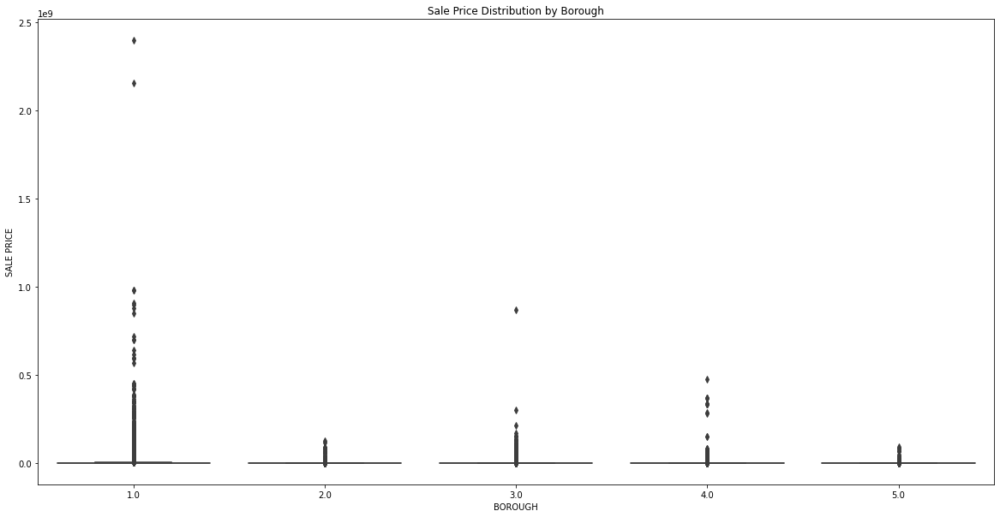

In [42]:
plt.figure(figsize=(20,10))
sns.boxplot(x='BOROUGH', y='SALE PRICE', data=df)
plt.title('Sale Price Distribution by Borough')
plt.show()

In [43]:
# summary of the number of nulls and count the ratio of missing values
miss_number()

,Total missing,% missing
EASE-MENT,157889,100.000000
APARTMENT NUMBER,120734,76.467645
LAND SQUARE FEET,35099,22.230174
GROSS SQUARE FEET,35099,22.230174
COMMERCIAL UNITS,33818,21.418845
RESIDENTIAL UNITS,26112,16.538201
TOTAL UNITS,24831,15.726871
YEAR BUILT,6765,4.284656
TAX CLASS AT PRESENT,91,0.057635
BUILDING CLASS AT PRESENT,91,0.057635


##EASE-MENT & APARTMENT NUMBER

> As we can see, Now we can handle every column

> now I will remove all columns which has missing values ratio more than or equal 50% of data

In [44]:
# specify the percentage of the missing data then remove it
percent = 50.0 # Like N %
min_count =  int(((100 - percent) / 100) * df.shape[0] + 1)
df.dropna(axis=1, thresh = min_count, inplace = True)

In [45]:
# summary of the number of nulls and count the ratio of missing values
miss_number()

,Total missing,% missing
LAND SQUARE FEET,35099,22.230174
GROSS SQUARE FEET,35099,22.230174
COMMERCIAL UNITS,33818,21.418845
RESIDENTIAL UNITS,26112,16.538201
TOTAL UNITS,24831,15.726871
YEAR BUILT,6765,4.284656
TAX CLASS AT PRESENT,91,0.057635
BUILDING CLASS AT PRESENT,91,0.057635
ZIP CODE,15,0.009500
SALE PRICE,0,0.000000


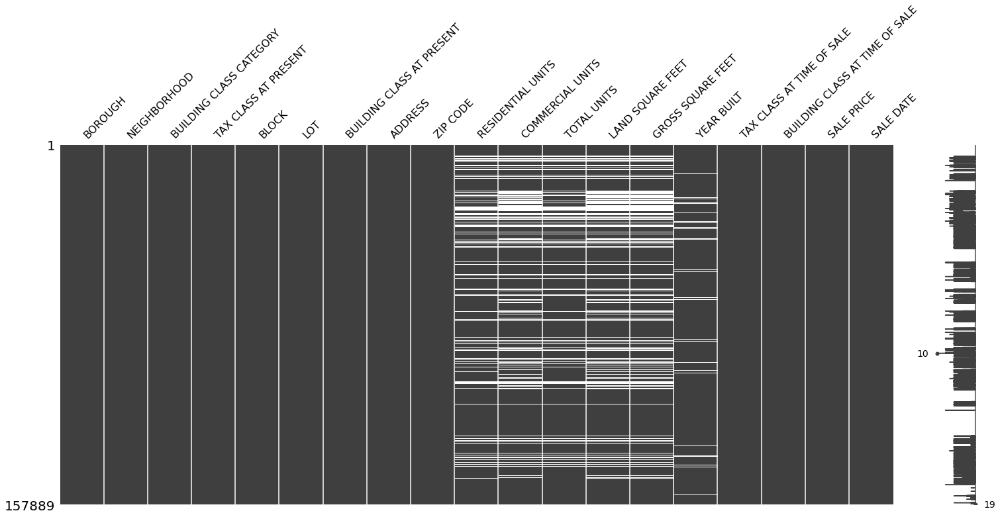

In [46]:
#visualize missing values as a matrix
msno.matrix(df, figsize=(25,10))

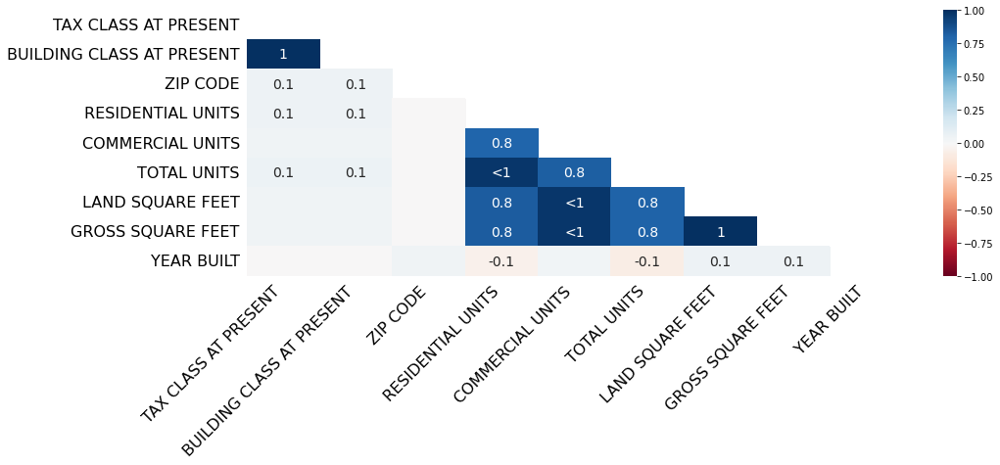

In [47]:
#bar chart
msno.heatmap(df, figsize=(15,5))

##'TAX CLASS AT PRESENT' & 'BUILDING CLASS AT PRESENT'

In [48]:
#display all the nulls records for these two columns
df[df['TAX CLASS AT PRESENT'].isna() & df['BUILDING CLASS AT PRESENT'].isna()].sort_values(by = list(df.columns))

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,BUILDING CLASS AT PRESENT,ADDRESS,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
5202,1.0,HARLEM-CENTRAL,15 CONDOS - 2-10 UNIT RESIDENTIAL,NaN,1928.0,1805.0,NaN,"215 WEST 122 STREET, 5",10027.0,NaN,NaN,NaN,NaN,NaN,2017.0,2.0,R1,1395000.0,2019-05-31
5491,1.0,MIDTOWN EAST,15 CONDOS - 2-10 UNIT RESIDENTIAL,NaN,1327.0,1305.0,NaN,"245 EAST 53RD STREET, 5",10022.0,NaN,NaN,NaN,NaN,NaN,2017.0,2.0,R1,1850000.0,2020-05-26
5743,1.0,MIDTOWN WEST,13 CONDOS - ELEVATOR APARTMENTS,NaN,1010.0,1804.0,NaN,"111 WEST 57TH STREET, 11B",10019.0,NaN,NaN,NaN,NaN,NaN,1924.0,2.0,R4,2117806.0,2020-04-15
10089,1.0,MURRAY HILL,13 CONDOS - ELEVATOR APARTMENTS,NaN,919.0,1206.0,NaN,"591 THIRD AVENUE, 3D",10016.0,NaN,NaN,NaN,NaN,NaN,2016.0,2.0,R4,1275813.0,2019-05-23
10091,1.0,MURRAY HILL,13 CONDOS - ELEVATOR APARTMENTS,NaN,919.0,1216.0,NaN,"591 THIRD AVENUE, 5E",10016.0,NaN,NaN,NaN,NaN,NaN,2016.0,2.0,R4,896060.0,2019-02-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1076,4.0,ASTORIA,13 CONDOS - ELEVATOR APARTMENTS,NaN,551.0,1047.0,NaN,21-17 31ST AVENUE,11106.0,NaN,NaN,NaN,NaN,NaN,2017.0,2.0,R4,725320.0,2018-05-14
1079,4.0,ASTORIA,13 CONDOS - ELEVATOR APARTMENTS,NaN,551.0,1053.0,NaN,21-17 31ST AVENUE,11106.0,NaN,NaN,NaN,NaN,NaN,2017.0,2.0,R4,1058980.0,2018-05-14
1081,4.0,ASTORIA,13 CONDOS - ELEVATOR APARTMENTS,NaN,551.0,1055.0,NaN,21-17 31ST AVENUE,11106.0,NaN,NaN,NaN,NaN,NaN,2017.0,2.0,R4,857875.0,2018-04-24
1082,4.0,ASTORIA,13 CONDOS - ELEVATOR APARTMENTS,NaN,551.0,1056.0,NaN,21-17 31ST AVENUE,11106.0,NaN,NaN,NaN,NaN,NaN,2017.0,2.0,R4,972428.0,2018-05-18


> I was searching for any pattern observation to know why this data is missing but I didn't find any reason for this missing data ,So I will drop thes missing values in these two column because they are less than 1% from the data

In [49]:
#drop all the nulls values for these two columns
df.dropna(axis = 'rows', subset = ['TAX CLASS AT PRESENT', 'BUILDING CLASS AT PRESENT'], inplace = True)

In [50]:
#checking for the null values
df['TAX CLASS AT PRESENT'].isna().sum()

0

In [51]:
len(df['BUILDING CLASS AT PRESENT'].value_counts())

174

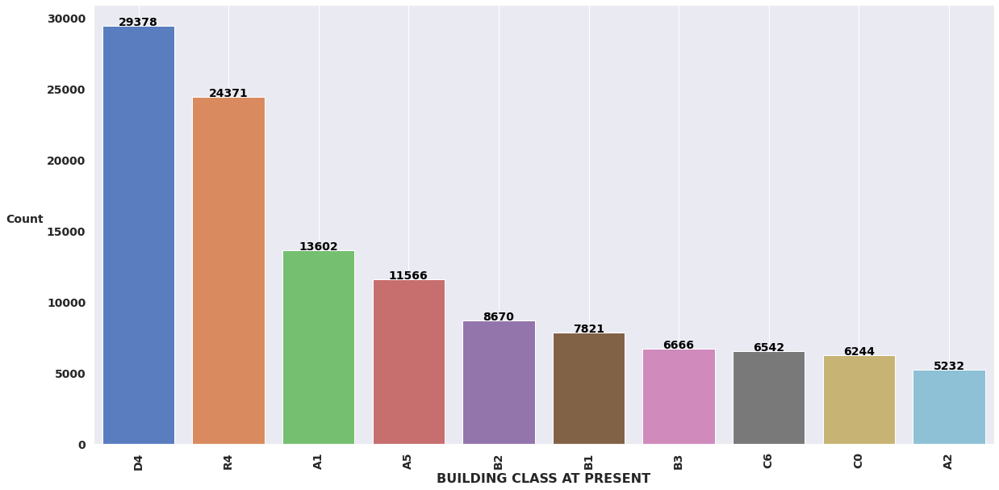

In [52]:
dist_plot('BUILDING CLASS AT PRESENT', 10)

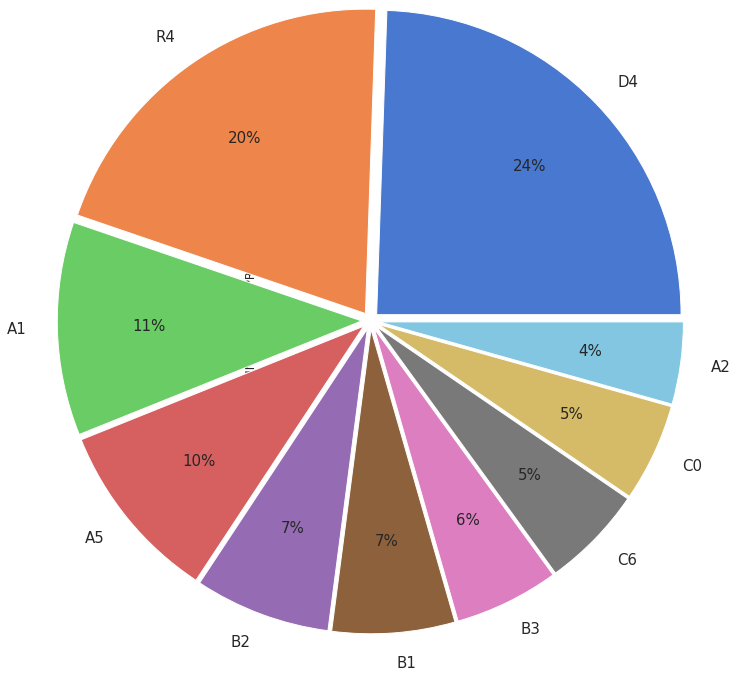

In [53]:
pie_plot('BUILDING CLASS AT PRESENT', 10)

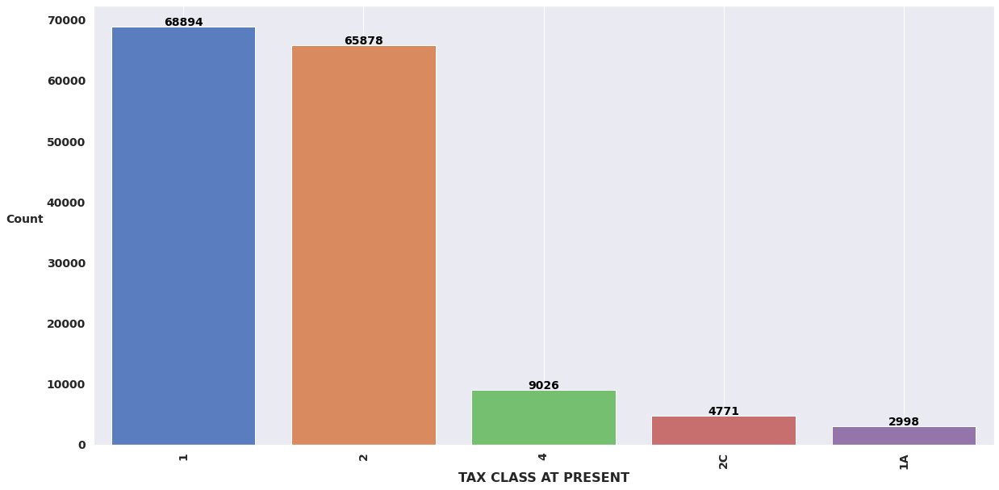

In [54]:
dist_plot('TAX CLASS AT PRESENT', 5)

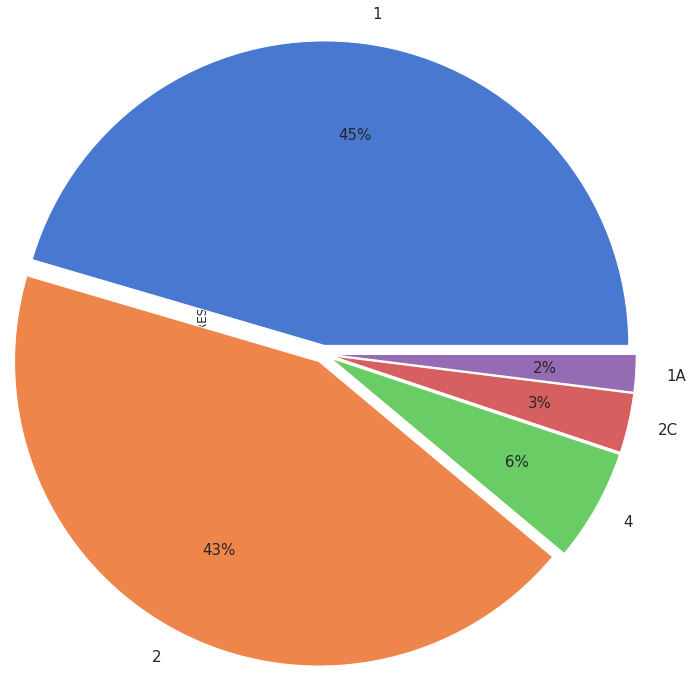

In [55]:
pie_plot('TAX CLASS AT PRESENT', 5)

##ZIP CODE

In [56]:
# summary of the number of nulls and count the ratio of missing values
miss_number()

,Total missing,% missing
GROSS SQUARE FEET,35008,22.185326
LAND SQUARE FEET,35008,22.185326
COMMERCIAL UNITS,33727,21.373528
RESIDENTIAL UNITS,26021,16.490070
TOTAL UNITS,24740,15.678272
YEAR BUILT,6763,4.285859
ZIP CODE,13,0.008238
SALE PRICE,0,0.000000
BUILDING CLASS AT TIME OF SALE,0,0.000000
TAX CLASS AT TIME OF SALE,0,0.000000


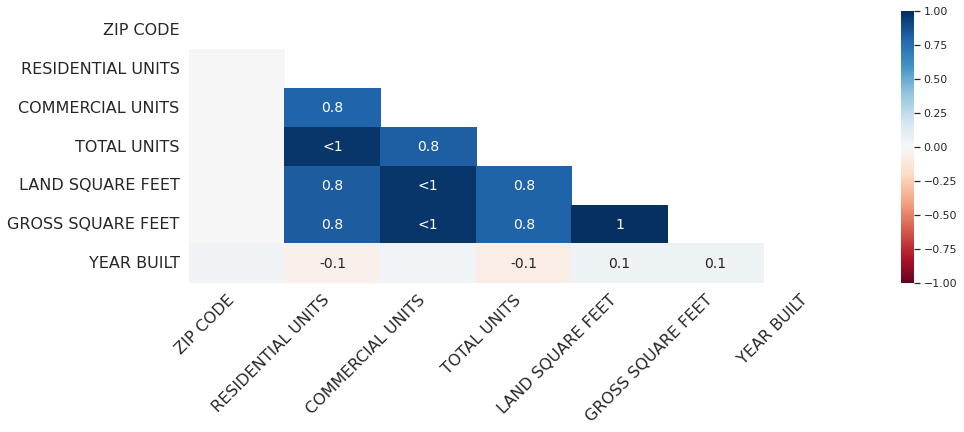

In [57]:
#bar chart
msno.heatmap(df, figsize=(15,5))

> 

> As we can see, `ZIP CODE` has no missing corrolation and has very low number of missing so i will drop these missing values from this column

In [58]:
# drop the record which has null value in 'ZIP CODE' column
df.dropna(axis = 'rows', subset = ['ZIP CODE'], inplace = True)

In [59]:
#checking for the null values
df['ZIP CODE'].isna().sum()

0

In [60]:
df['ZIP CODE'].value_counts()

10314.0    2822
10023.0    2526
11375.0    2443
10312.0    2397
11201.0    2163
           ... 
10167.0       1
10177.0       1
10169.0       1
10020.0       1
10171.0       1
Name: ZIP CODE, Length: 194, dtype: int64

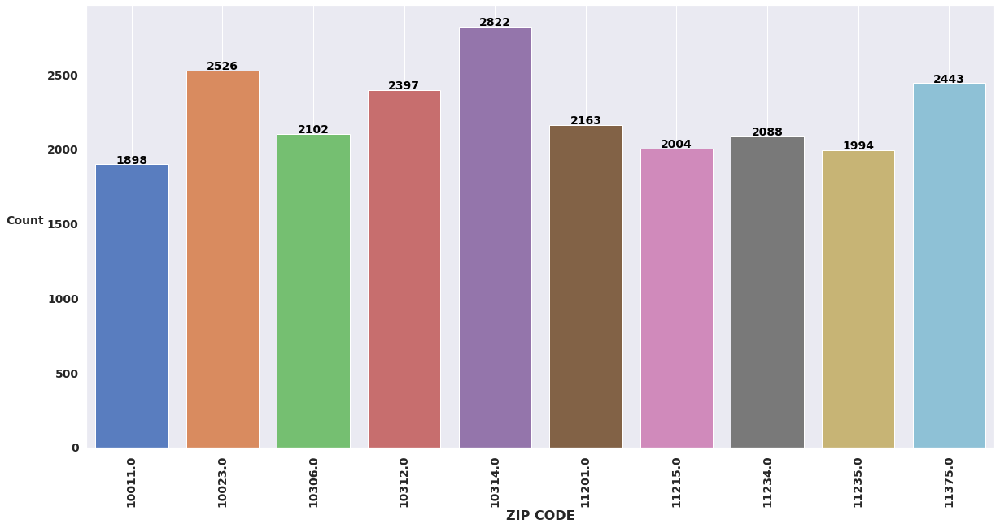

In [61]:
dist_plot('ZIP CODE', 10)

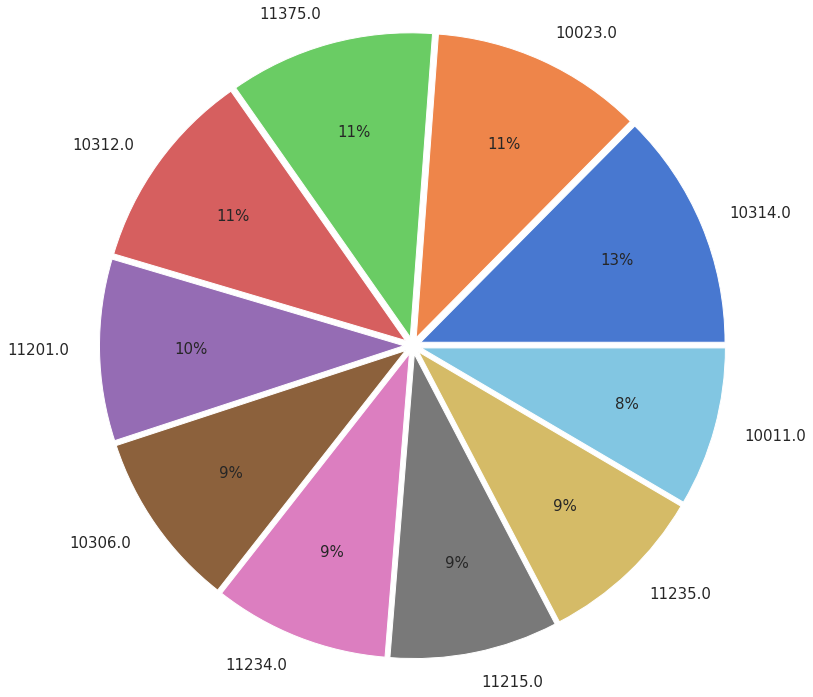

In [62]:
pie_plot('ZIP CODE', 10)

##YEAR BUILT

###Hanling the missing values

> As we can see from the previous figures and results, The `YEAR BUILT` column has no missing corrolation with any of these missing values columns so I will search for any pattern to see why these records are missing then I will decide if I will using single imputer or multiple imputer

In [63]:
#display all the nulls records for these two columns
df[df['YEAR BUILT'].isna()].sort_values(by = list(df.columns))

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,BUILDING CLASS AT PRESENT,ADDRESS,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
93,1.0,ALPHABET CITY,11 SPECIAL CONDO BILLING LOTS,2,377.0,1204.0,RR,"101 AVENUE D, B-1",10009.0,61.0,1.0,62.0,"15,153","40,712",NaN,2.0,RR,5100000.0,2019-12-13
74,1.0,ALPHABET CITY,12 CONDOS - WALKUP APARTMENTS,2,393.0,1021.0,R2,"383 EAST 10TH STREET, E1",10009.0,1,NaN,1,NaN,NaN,NaN,2.0,R2,1325000.0,2020-11-23
75,1.0,ALPHABET CITY,12 CONDOS - WALKUP APARTMENTS,2,393.0,1030.0,R2,"383 E 10TH STREET, B4",10009.0,1,NaN,1,NaN,NaN,NaN,2.0,R2,1190000.0,2020-03-16
77,1.0,ALPHABET CITY,12 CONDOS - WALKUP APARTMENTS,2,398.0,1034.0,R2,"182 EAST 2ND STREET, 5F",10009.0,1,NaN,1,NaN,NaN,NaN,2.0,R2,670000.0,2020-04-01
98,1.0,ALPHABET CITY,13 CONDOS - ELEVATOR APARTMENTS,2,375.0,1017.0,R4,"754 EAST 6TH STREET, 5A",10009.0,1.0,0.0,1.0,0,0,NaN,2.0,R4,1095000.0,2019-04-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8164,5.0,WILLOWBROOK,05 TAX CLASS 1 VACANT LAND,1B,742.0,4.0,V0,N/A VICTORY BOULEVARD,10314.0,0.0,0.0,0.0,"3,580",0,NaN,1.0,V0,950000.0,2019-06-28
5976,5.0,WILLOWBROOK,05 TAX CLASS 1 VACANT LAND,1B,825.0,48.0,V0,N/A SUNSET AVENUE,10302.0,0.0,0.0,0.0,"2,440",0,NaN,1.0,V0,5000.0,2020-01-06
6102,5.0,WOODROW,05 TAX CLASS 1 VACANT LAND,1B,7094.0,1.0,V0,72 HARRIS LANE,10309.0,0.0,0.0,0.0,"6,079",0,NaN,1.0,V0,500000.0,2020-06-02
6103,5.0,WOODROW,05 TAX CLASS 1 VACANT LAND,1B,7094.0,3.0,V0,74 HARRIS LANE,10309.0,0.0,0.0,0.0,"5,685",0,NaN,1.0,V0,500000.0,2020-06-02


> I didn't find any observation for those missing values so I will use `SimpleImputer` with `median` strategy to fill these null values

In [64]:
#using SimpleImputer model to fill the null values by using `Median`
imputer = SimpleImputer(missing_values=np.NaN, strategy='median')
df['YEAR BUILT'] = imputer.fit_transform(df['YEAR BUILT'].values.reshape(-1,1))

In [65]:
#take the round of the values because the years numbers not include aany decimal number
df['YEAR BUILT'] = df['YEAR BUILT'].round()

In [66]:
#checking for null values
df['YEAR BUILT'].isna().sum()

0

In [67]:
# checking for the distribution
df['YEAR BUILT'].value_counts()

1920.0    11361
1930.0     8952
1925.0     8090
1946.0     6896
1950.0     6018
          ...  
1854.0        1
1888.0        1
1857.0        1
1884.0        1
1030.0        1
Name: YEAR BUILT, Length: 181, dtype: int64

###Outliers

In [68]:
#convert from scientific notation to describe dataset
df.describe().apply(lambda s: s.apply('{0:.5f}'.format)).transpose()

,count,mean,std,min,25%,50%,75%,max
BOROUGH,157785.00000,2.96239,1.31585,1.00000,2.00000,3.00000,4.00000,5.00000
BLOCK,157785.00000,4302.27247,3674.55627,1.00000,1309.00000,3302.00000,6369.00000,16350.00000
LOT,157785.00000,381.74465,667.82468,1.00000,21.00000,50.00000,1002.00000,9116.00000
ZIP CODE,157785.00000,10812.03978,719.22641,0.00000,10304.00000,11207.00000,11357.00000,11697.00000
YEAR BUILT,157785.00000,1906.29190,295.62808,0.00000,1925.00000,1946.00000,1969.00000,2021.00000
TAX CLASS AT TIME OF SALE,157785.00000,1.64485,0.75720,1.00000,1.00000,2.00000,2.00000,4.00000
SALE PRICE,157785.00000,1891020.15867,14694234.19232,1.00000,425000.00000,680000.00000,1150000.00000,2397501899.00000


> As we can see, there is some thing wierd because the `minimum` value for the `YEAR BUILT` column is `0` Which is meaningless

In [69]:
#Checking for outliers boundaries
fig = px.histogram(df, x="YEAR BUILT", marginal="box")
fig.show()

> If we looking for this diagram we will find that
* min = 1865
* q1 = 1925
* median = 1946
* q3 = 1965
* upper = 2021

> So I will Replace all values that's less than `1865` and more than `2021` with median `1946`

In [70]:
df['YEAR BUILT'] = np.where(df['YEAR BUILT'] > 2021, 1946, df['YEAR BUILT'])
df['YEAR BUILT'] = np.where(df['YEAR BUILT'] < 1925, 1946, df['YEAR BUILT'])
df.describe()

,BOROUGH,BLOCK,LOT,ZIP CODE,YEAR BUILT,TAX CLASS AT TIME OF SALE,SALE PRICE
count,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,1.577850e+05
mean,2.962386,4302.272466,381.744653,10812.039776,1958.730849,1.644852,1.891020e+06
std,1.315847,3674.556274,667.824685,719.226413,26.974901,0.757199,1.469423e+07
min,1.000000,1.000000,1.000000,0.000000,1925.000000,1.000000,1.000000e+00
25%,2.000000,1309.000000,21.000000,10304.000000,1946.000000,1.000000,4.250000e+05
50%,3.000000,3302.000000,50.000000,11207.000000,1946.000000,2.000000,6.800000e+05
75%,4.000000,6369.000000,1002.000000,11357.000000,1969.000000,2.000000,1.150000e+06
max,5.000000,16350.000000,9116.000000,11697.000000,2021.000000,4.000000,2.397502e+09


###Virtualization

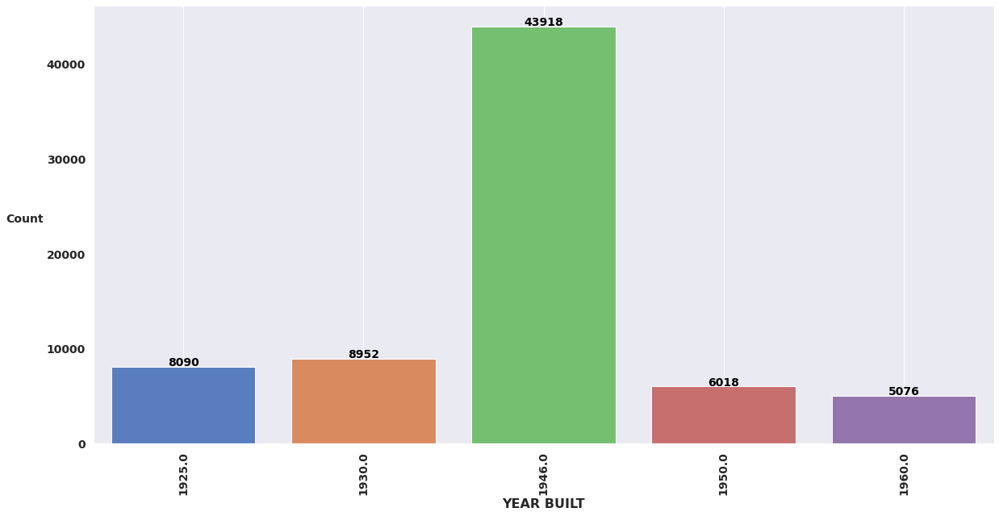

In [71]:
dist_plot('YEAR BUILT', 5)

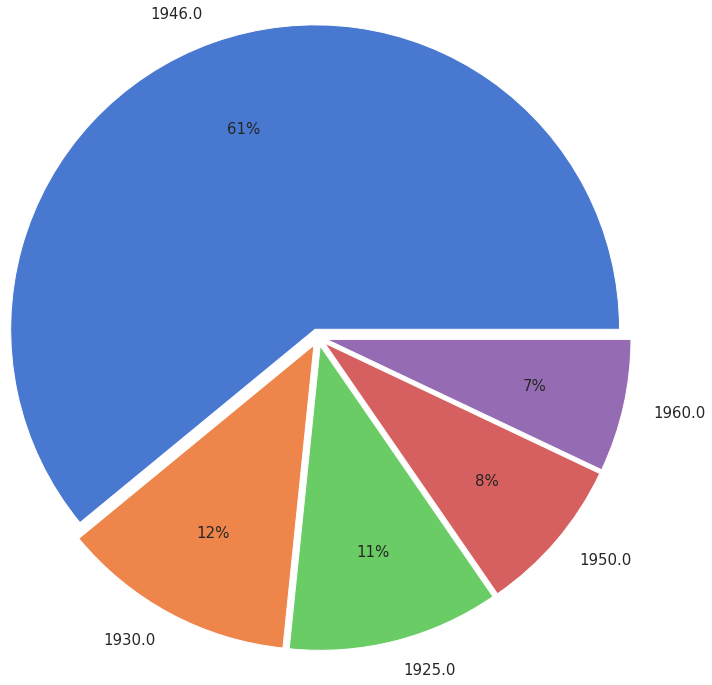

In [72]:
pie_plot('YEAR BUILT', 5)

##COMMERCIAL UNITS & RESIDENTIAL UNITS & TOTAL UNITS

In [73]:
# summary of the number of nulls and count the ratio of missing values
miss_number()

,Total missing,% missing
GROSS SQUARE FEET,35008,22.187153
LAND SQUARE FEET,35008,22.187153
COMMERCIAL UNITS,33727,21.375289
RESIDENTIAL UNITS,26021,16.491428
TOTAL UNITS,24740,15.679564
SALE PRICE,0,0.000000
BUILDING CLASS AT TIME OF SALE,0,0.000000
TAX CLASS AT TIME OF SALE,0,0.000000
YEAR BUILT,0,0.000000
BOROUGH,0,0.000000


###COMMERCIAL UNITS

In [74]:
# checking for the distribution
len(df['COMMERCIAL UNITS'].value_counts())

103

In [75]:
#convert categorical to numerical 
df['COMMERCIAL UNITS'] = pd.to_numeric(df['COMMERCIAL UNITS'], errors='coerce')

In [76]:
# checking for the distribution
len(df['COMMERCIAL UNITS'].value_counts())

82

###RESIDENTIAL UNITS

In [77]:
# checking for the distribution
len(df['RESIDENTIAL UNITS'].value_counts())

274

In [78]:
df['RESIDENTIAL UNITS'].value_counts()

1.0      51085
2.0      19757
1        17839
0.0      15022
0         8651
         ...  
283.0        1
312.0        1
464.0        1
180.0        1
144.0        1
Name: RESIDENTIAL UNITS, Length: 274, dtype: int64

In [79]:
#convert categorical to numerical 
df['RESIDENTIAL UNITS'] = pd.to_numeric(df['RESIDENTIAL UNITS'], errors='coerce')

In [80]:
# checking for the distribution
len(df['RESIDENTIAL UNITS'].value_counts())

185

###TOTAL UNITS

In [81]:
# checking for the distribution
len(df['TOTAL UNITS'].value_counts())

297

In [82]:
df['TOTAL UNITS'].value_counts()

1.0      55135
2.0      19717
1        18788
0.0      10327
0         7338
         ...  
148.0        1
288.0        1
262.0        1
286.0        1
142.0        1
Name: TOTAL UNITS, Length: 297, dtype: int64

In [83]:
#convert categorical to numerical 
df['TOTAL UNITS'] = pd.to_numeric(df['TOTAL UNITS'], errors='coerce')

In [84]:
# checking for the distribution
len(df['TOTAL UNITS'].value_counts())

200

###Handling Missing values

In [85]:
# summary of the number of nulls and count the ratio of missing values
miss_number()

,Total missing,% missing
GROSS SQUARE FEET,35008,22.187153
LAND SQUARE FEET,35008,22.187153
COMMERCIAL UNITS,33727,21.375289
RESIDENTIAL UNITS,26024,16.493330
TOTAL UNITS,24743,15.681465
SALE PRICE,0,0.000000
BUILDING CLASS AT TIME OF SALE,0,0.000000
TAX CLASS AT TIME OF SALE,0,0.000000
YEAR BUILT,0,0.000000
BOROUGH,0,0.000000


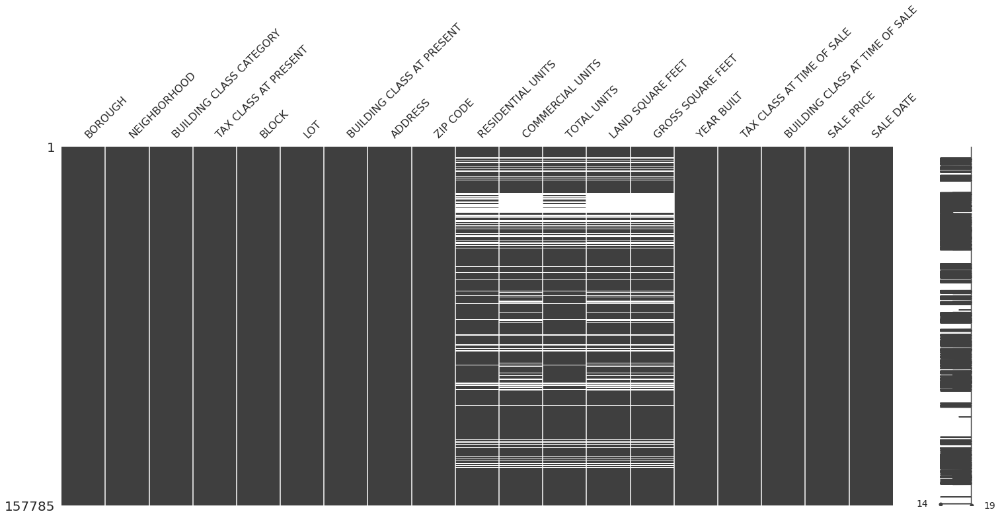

In [86]:
#visualize missing values as a matrix
msno.matrix(df, figsize=(25,10))

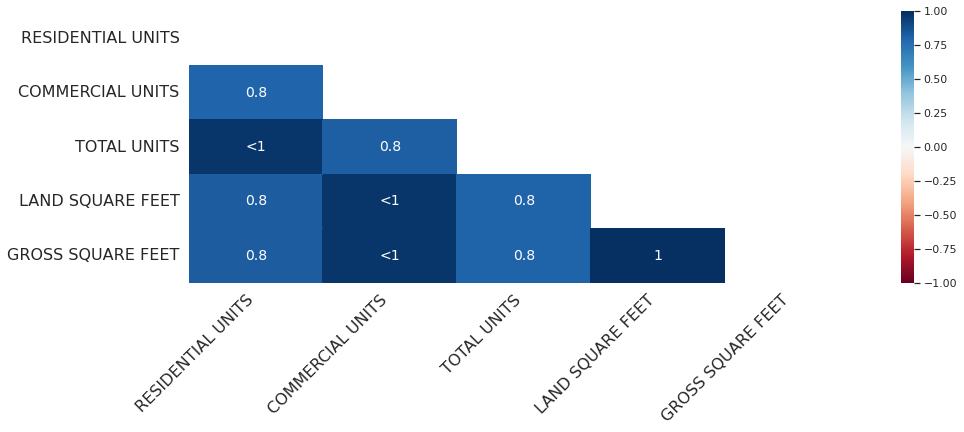

In [87]:
#bar chart
msno.heatmap(df, figsize=(15,5))

> I did search for any observation for why these data is missing but I didn't find any observation

> As we can see there is a pattern between these `3` columns and they have very high missing correlation between each other, So I will use them to fill the nulls

> I will use `IterativeImputer` to fill the null values for all of these columns

In [88]:
imputer = IterativeImputer(max_iter=20, random_state=42)
df[['COMMERCIAL UNITS',  'RESIDENTIAL UNITS', 'TOTAL UNITS']] = imputer.fit_transform(df[['COMMERCIAL UNITS',  'RESIDENTIAL UNITS', 'TOTAL UNITS']])

In [89]:
df[['COMMERCIAL UNITS',  'RESIDENTIAL UNITS', 'TOTAL UNITS']] = df[['COMMERCIAL UNITS',  'RESIDENTIAL UNITS', 'TOTAL UNITS']].abs().apply(np.ceil)

In [90]:
# summary of the number of nulls and count the ratio of missing values
miss_number()

,Total missing,% missing
GROSS SQUARE FEET,35008,22.187153
LAND SQUARE FEET,35008,22.187153
BOROUGH,0,0.000000
COMMERCIAL UNITS,0,0.000000
SALE PRICE,0,0.000000
BUILDING CLASS AT TIME OF SALE,0,0.000000
TAX CLASS AT TIME OF SALE,0,0.000000
YEAR BUILT,0,0.000000
TOTAL UNITS,0,0.000000
RESIDENTIAL UNITS,0,0.000000


###Handling Outliers values

####COMMERCIAL UNITS

In [91]:
#convert from scientific notation to describe dataset
df.describe().apply(lambda s: s.apply('{0:.5f}'.format)).transpose()

,count,mean,std,min,25%,50%,75%,max
BOROUGH,157785.00000,2.96239,1.31585,1.00000,2.00000,3.00000,4.00000,5.00000
BLOCK,157785.00000,4302.27247,3674.55627,1.00000,1309.00000,3302.00000,6369.00000,16350.00000
LOT,157785.00000,381.74465,667.82468,1.00000,21.00000,50.00000,1002.00000,9116.00000
ZIP CODE,157785.00000,10812.03978,719.22641,0.00000,10304.00000,11207.00000,11357.00000,11697.00000
RESIDENTIAL UNITS,157785.00000,2.18617,12.06106,0.00000,1.00000,1.00000,2.00000,600.00000
COMMERCIAL UNITS,157785.00000,0.46099,5.46089,0.00000,0.00000,0.00000,1.00000,570.00000
TOTAL UNITS,157785.00000,2.46352,13.32917,0.00000,1.00000,1.00000,2.00000,611.00000
YEAR BUILT,157785.00000,1958.73085,26.97490,1925.00000,1946.00000,1946.00000,1969.00000,2021.00000
TAX CLASS AT TIME OF SALE,157785.00000,1.64485,0.75720,1.00000,1.00000,2.00000,2.00000,4.00000
SALE PRICE,157785.00000,1891020.15867,14694234.19232,1.00000,425000.00000,680000.00000,1150000.00000,2397501899.00000


In [92]:
#Checking for outliers boundaries
fig = px.histogram(df, x="COMMERCIAL UNITS", marginal="box")
fig.show()

In [93]:
print(df['COMMERCIAL UNITS'].quantile(0.10))
print(df['COMMERCIAL UNITS'].quantile(0.95))

0.0
1.0


> If we looking for this diagram we will find that
* 10% = 0
* median = 1
* 95% = 1
* upper = 2

> So I will Replace all values that's less than `0`  with `0` and more than `2` with median `1`

In [94]:
df['COMMERCIAL UNITS'] = np.where(df['COMMERCIAL UNITS'] > 2, 1, df['COMMERCIAL UNITS'])
df['COMMERCIAL UNITS'] = np.where(df['COMMERCIAL UNITS'] < 0, 0, df['COMMERCIAL UNITS'])
df.describe()

,BOROUGH,BLOCK,LOT,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,YEAR BUILT,TAX CLASS AT TIME OF SALE,SALE PRICE
count,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,1.577850e+05
mean,2.962386,4302.272466,381.744653,10812.039776,2.186171,0.291346,2.463523,1958.730849,1.644852,1.891020e+06
std,1.315847,3674.556274,667.824685,719.226413,12.061062,0.470110,13.329174,26.974901,0.757199,1.469423e+07
min,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1925.000000,1.000000,1.000000e+00
25%,2.000000,1309.000000,21.000000,10304.000000,1.000000,0.000000,1.000000,1946.000000,1.000000,4.250000e+05
50%,3.000000,3302.000000,50.000000,11207.000000,1.000000,0.000000,1.000000,1946.000000,2.000000,6.800000e+05
75%,4.000000,6369.000000,1002.000000,11357.000000,2.000000,1.000000,2.000000,1969.000000,2.000000,1.150000e+06
max,5.000000,16350.000000,9116.000000,11697.000000,600.000000,2.000000,611.000000,2021.000000,4.000000,2.397502e+09


####RESIDENTIAL UNITS

In [95]:
#convert from scientific notation to describe dataset
df.describe().apply(lambda s: s.apply('{0:.5f}'.format)).transpose()

,count,mean,std,min,25%,50%,75%,max
BOROUGH,157785.00000,2.96239,1.31585,1.00000,2.00000,3.00000,4.00000,5.00000
BLOCK,157785.00000,4302.27247,3674.55627,1.00000,1309.00000,3302.00000,6369.00000,16350.00000
LOT,157785.00000,381.74465,667.82468,1.00000,21.00000,50.00000,1002.00000,9116.00000
ZIP CODE,157785.00000,10812.03978,719.22641,0.00000,10304.00000,11207.00000,11357.00000,11697.00000
RESIDENTIAL UNITS,157785.00000,2.18617,12.06106,0.00000,1.00000,1.00000,2.00000,600.00000
COMMERCIAL UNITS,157785.00000,0.29135,0.47011,0.00000,0.00000,0.00000,1.00000,2.00000
TOTAL UNITS,157785.00000,2.46352,13.32917,0.00000,1.00000,1.00000,2.00000,611.00000
YEAR BUILT,157785.00000,1958.73085,26.97490,1925.00000,1946.00000,1946.00000,1969.00000,2021.00000
TAX CLASS AT TIME OF SALE,157785.00000,1.64485,0.75720,1.00000,1.00000,2.00000,2.00000,4.00000
SALE PRICE,157785.00000,1891020.15867,14694234.19232,1.00000,425000.00000,680000.00000,1150000.00000,2397501899.00000


In [96]:
#Checking for outliers boundaries
fig = px.histogram(df, x="RESIDENTIAL UNITS", marginal="box")
fig.show()

In [97]:
print(df['RESIDENTIAL UNITS'].quantile(0.10))
print(df['RESIDENTIAL UNITS'].quantile(0.95))

0.0
3.0


> If we looking for this diagram we will find that
* 10% = 0
* median = 1
* 95% = 3
* upper = 3

> So I will Replace all values that's less than `0`  with `0` and more than `3` with median `1`

In [98]:
df['RESIDENTIAL UNITS'] = np.where(df['RESIDENTIAL UNITS'] > 3, 1, df['RESIDENTIAL UNITS'])
df['RESIDENTIAL UNITS'] = np.where(df['RESIDENTIAL UNITS'] < 0, 0, df['RESIDENTIAL UNITS'])
df.describe()

,BOROUGH,BLOCK,LOT,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,YEAR BUILT,TAX CLASS AT TIME OF SALE,SALE PRICE
count,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,1.577850e+05
mean,2.962386,4302.272466,381.744653,10812.039776,1.418557,0.291346,2.463523,1958.730849,1.644852,1.891020e+06
std,1.315847,3674.556274,667.824685,719.226413,0.969617,0.470110,13.329174,26.974901,0.757199,1.469423e+07
min,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1925.000000,1.000000,1.000000e+00
25%,2.000000,1309.000000,21.000000,10304.000000,1.000000,0.000000,1.000000,1946.000000,1.000000,4.250000e+05
50%,3.000000,3302.000000,50.000000,11207.000000,1.000000,0.000000,1.000000,1946.000000,2.000000,6.800000e+05
75%,4.000000,6369.000000,1002.000000,11357.000000,2.000000,1.000000,2.000000,1969.000000,2.000000,1.150000e+06
max,5.000000,16350.000000,9116.000000,11697.000000,3.000000,2.000000,611.000000,2021.000000,4.000000,2.397502e+09


####TOTAL UNITS

In [99]:
#convert from scientific notation to describe dataset
df.describe().apply(lambda s: s.apply('{0:.5f}'.format)).transpose()

,count,mean,std,min,25%,50%,75%,max
BOROUGH,157785.00000,2.96239,1.31585,1.00000,2.00000,3.00000,4.00000,5.00000
BLOCK,157785.00000,4302.27247,3674.55627,1.00000,1309.00000,3302.00000,6369.00000,16350.00000
LOT,157785.00000,381.74465,667.82468,1.00000,21.00000,50.00000,1002.00000,9116.00000
ZIP CODE,157785.00000,10812.03978,719.22641,0.00000,10304.00000,11207.00000,11357.00000,11697.00000
RESIDENTIAL UNITS,157785.00000,1.41856,0.96962,0.00000,1.00000,1.00000,2.00000,3.00000
COMMERCIAL UNITS,157785.00000,0.29135,0.47011,0.00000,0.00000,0.00000,1.00000,2.00000
TOTAL UNITS,157785.00000,2.46352,13.32917,0.00000,1.00000,1.00000,2.00000,611.00000
YEAR BUILT,157785.00000,1958.73085,26.97490,1925.00000,1946.00000,1946.00000,1969.00000,2021.00000
TAX CLASS AT TIME OF SALE,157785.00000,1.64485,0.75720,1.00000,1.00000,2.00000,2.00000,4.00000
SALE PRICE,157785.00000,1891020.15867,14694234.19232,1.00000,425000.00000,680000.00000,1150000.00000,2397501899.00000


In [100]:
#Checking for outliers boundaries
fig = px.histogram(df, x="TOTAL UNITS", marginal="box")
fig.show()

In [101]:
print(df['TOTAL UNITS'].quantile(0.10))
print(df['TOTAL UNITS'].quantile(0.95))

0.0
3.0


> If we looking for this diagram we will find that
* 10% = 0
* median = 1
* 95% = 3
* upper = 3

> So I will Replace all values that's less than `0`  with `0` and more than `3` with median `1`

In [102]:
df['TOTAL UNITS'] = np.where(df['TOTAL UNITS'] > 3, 1, df['TOTAL UNITS'])
df['TOTAL UNITS'] = np.where(df['TOTAL UNITS'] < 0, 0, df['TOTAL UNITS'])
df.describe()

,BOROUGH,BLOCK,LOT,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,YEAR BUILT,TAX CLASS AT TIME OF SALE,SALE PRICE
count,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,1.577850e+05
mean,2.962386,4302.272466,381.744653,10812.039776,1.418557,0.291346,1.470171,1958.730849,1.644852,1.891020e+06
std,1.315847,3674.556274,667.824685,719.226413,0.969617,0.470110,0.940350,26.974901,0.757199,1.469423e+07
min,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1925.000000,1.000000,1.000000e+00
25%,2.000000,1309.000000,21.000000,10304.000000,1.000000,0.000000,1.000000,1946.000000,1.000000,4.250000e+05
50%,3.000000,3302.000000,50.000000,11207.000000,1.000000,0.000000,1.000000,1946.000000,2.000000,6.800000e+05
75%,4.000000,6369.000000,1002.000000,11357.000000,2.000000,1.000000,2.000000,1969.000000,2.000000,1.150000e+06
max,5.000000,16350.000000,9116.000000,11697.000000,3.000000,2.000000,3.000000,2021.000000,4.000000,2.397502e+09


###Virtualization

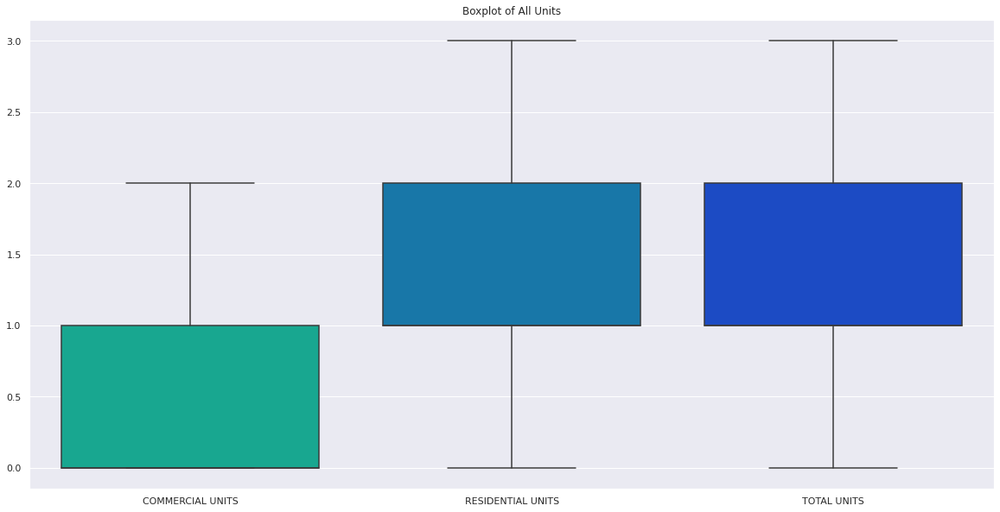

In [103]:
#Set the size of the plot
plt.figure(figsize=(20,10))

df_ = df[['COMMERCIAL UNITS','RESIDENTIAL UNITS','TOTAL UNITS']]
sns.boxplot(data=df_, palette="winter_r")
plt.title('Boxplot of All Units')
plt.show()

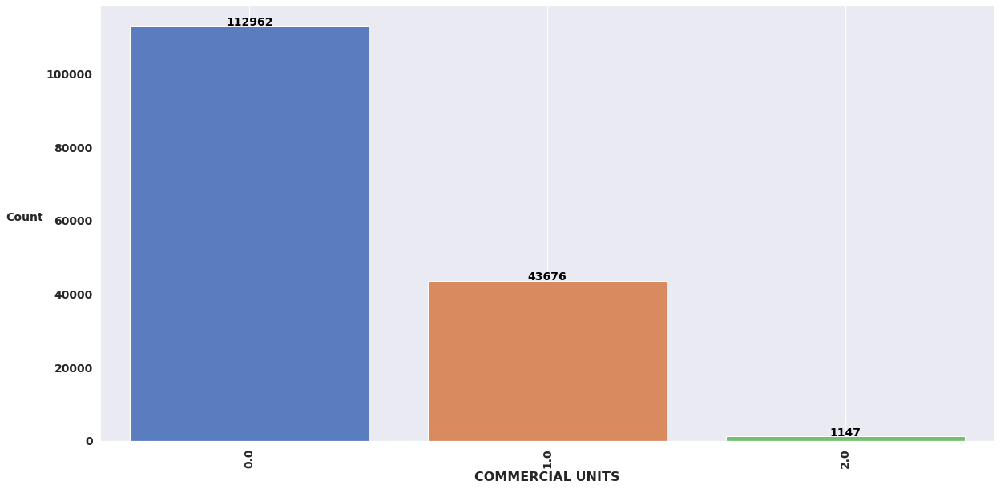

In [104]:
dist_plot('COMMERCIAL UNITS', 10)

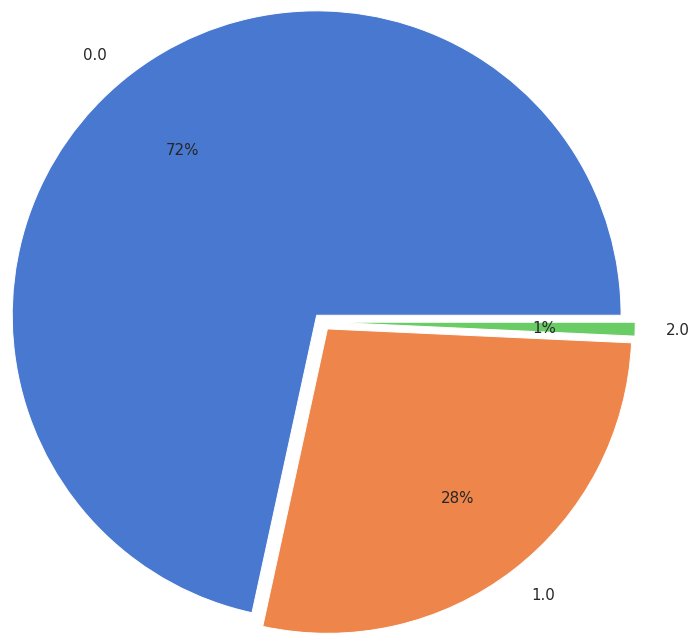

In [105]:
pie_plot('COMMERCIAL UNITS', 3)

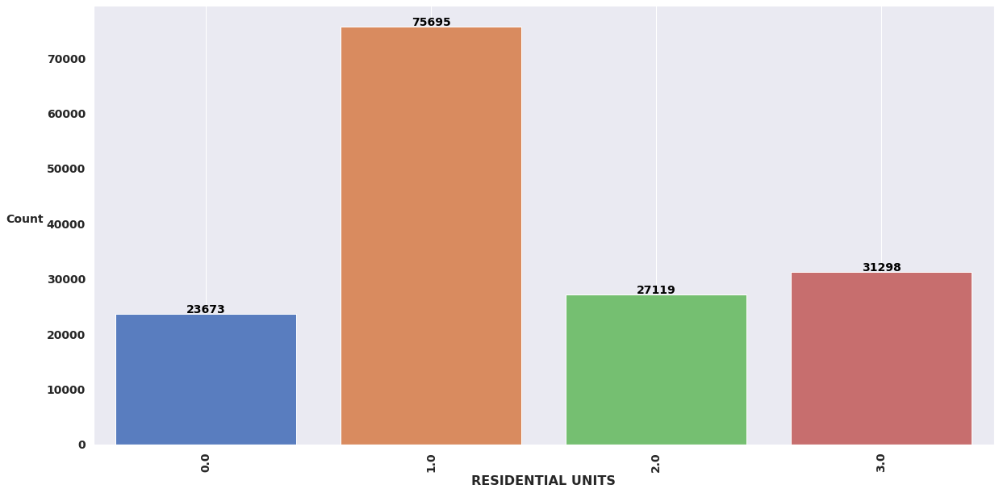

In [106]:
dist_plot('RESIDENTIAL UNITS', 10)

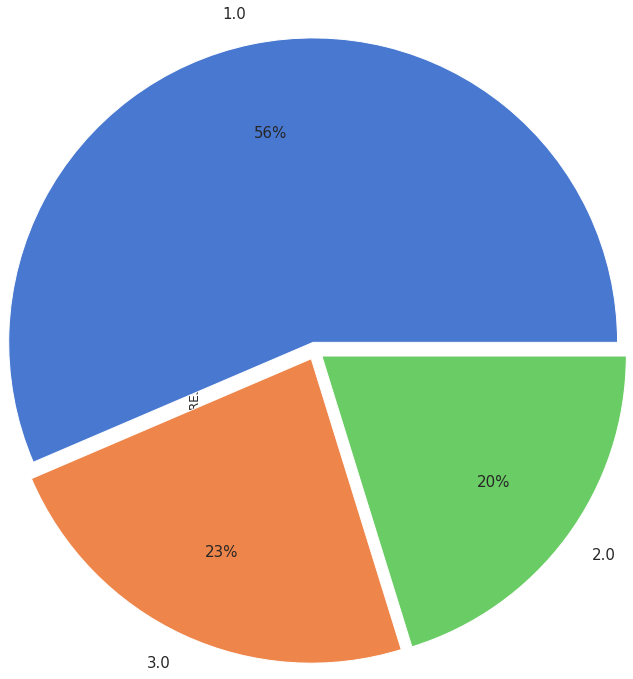

In [107]:
pie_plot('RESIDENTIAL UNITS', 3)

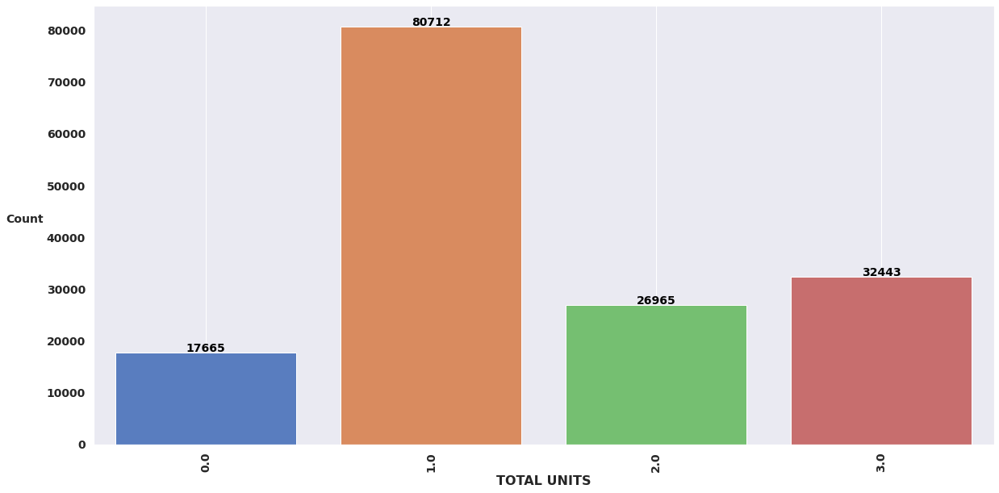

In [108]:
dist_plot('TOTAL UNITS', 10)

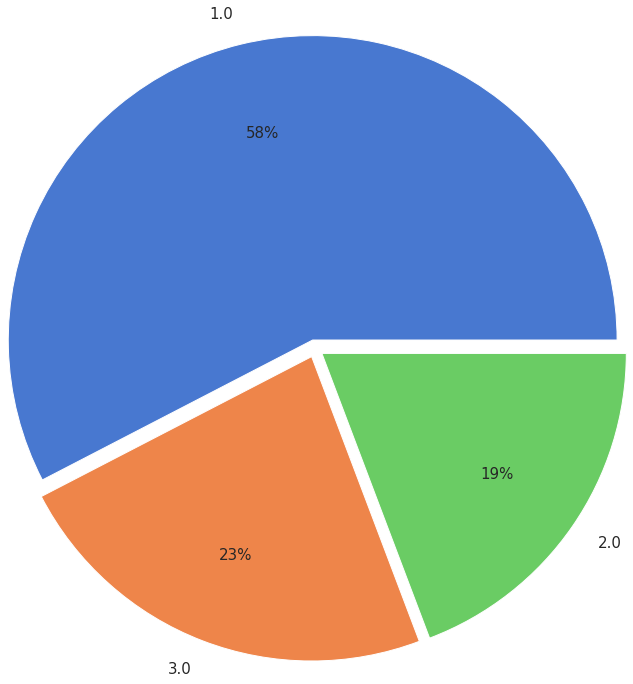

In [109]:
pie_plot('TOTAL UNITS', 3)

##LAND SQUARE FEET & GROSS SQUARE FEET

###LAND SQUARE FEET

In [110]:
# checking for the distribution
len(df['LAND SQUARE FEET'].value_counts())

8299

In [111]:
clean = lambda x: x.str.replace(',', '').str.strip().astype(float)

In [112]:
#convert categorical to numerical 
df['LAND SQUARE FEET'] = clean(df['LAND SQUARE FEET'])

In [113]:
# checking for the distribution
len(df['LAND SQUARE FEET'].value_counts())

8299

###GROSS SQUARE FEET

In [114]:
# checking for the distribution
len(df['GROSS SQUARE FEET'].value_counts())

7527

In [115]:
clean = lambda x: x.str.replace(',', '').str.strip().astype(float)

In [116]:
#convert categorical to numerical 
df['GROSS SQUARE FEET'] = clean(df['GROSS SQUARE FEET'])

In [117]:
# checking for the distribution
len(df['GROSS SQUARE FEET'].value_counts())

7527

###Handling missing values

In [118]:
# summary of the number of nulls and count the ratio of missing values
miss_number()

,Total missing,% missing
GROSS SQUARE FEET,35008,22.187153
LAND SQUARE FEET,35008,22.187153
BOROUGH,0,0.000000
COMMERCIAL UNITS,0,0.000000
SALE PRICE,0,0.000000
BUILDING CLASS AT TIME OF SALE,0,0.000000
TAX CLASS AT TIME OF SALE,0,0.000000
YEAR BUILT,0,0.000000
TOTAL UNITS,0,0.000000
RESIDENTIAL UNITS,0,0.000000


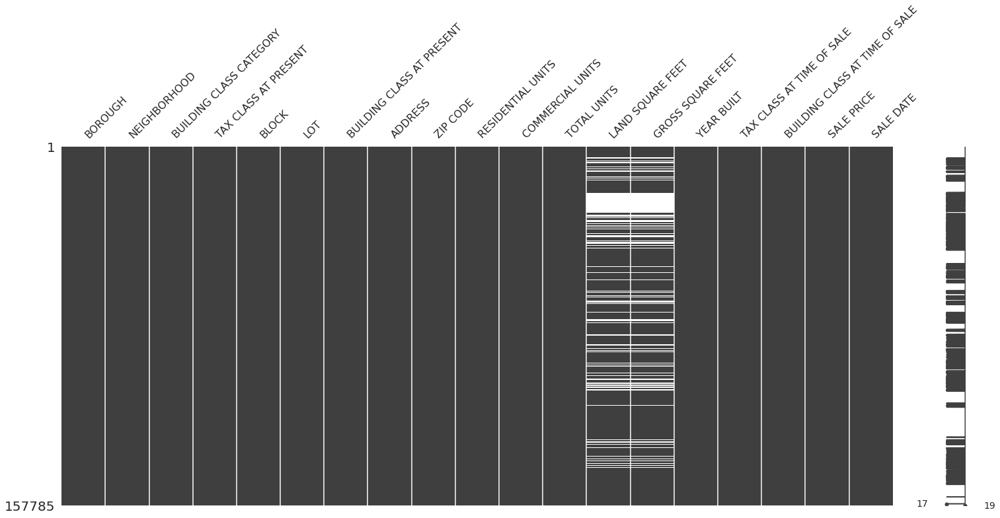

In [119]:
#visualize missing values as a matrix
msno.matrix(df, figsize=(25,10))

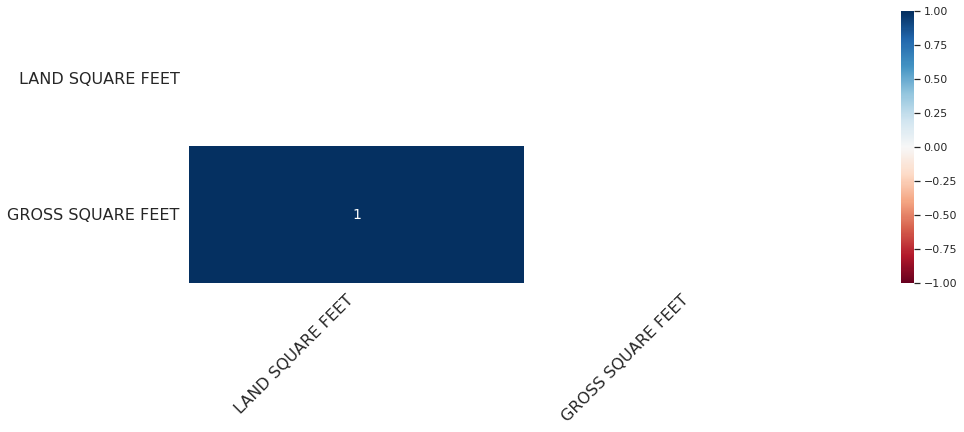

In [120]:
#bar chart
msno.heatmap(df, figsize=(15,5))

> I did search for any observation for why these data is missing but I didn't find any observation

> As we can see there is a pattern between these `2` columns and they have very high missing correlation between each other, So I will use them to fill the nulls in each other

> I will use `IterativeImputer` to fill the null values for all of these columns

In [121]:
imputer = IterativeImputer(max_iter=30, random_state=42)
df[['LAND SQUARE FEET', 'GROSS SQUARE FEET']] = imputer.fit_transform(df[['LAND SQUARE FEET', 'GROSS SQUARE FEET']])

In [122]:
df[['LAND SQUARE FEET', 'GROSS SQUARE FEET']] = df[['LAND SQUARE FEET', 'GROSS SQUARE FEET']].abs().apply(np.ceil)

###Handling Outliers values

####LAND SQUARE FEET

In [123]:
#convert from scientific notation to describe dataset
df.describe().apply(lambda s: s.apply('{0:.5f}'.format)).transpose()

,count,mean,std,min,25%,50%,75%,max
BOROUGH,157785.00000,2.96239,1.31585,1.00000,2.00000,3.00000,4.00000,5.00000
BLOCK,157785.00000,4302.27247,3674.55627,1.00000,1309.00000,3302.00000,6369.00000,16350.00000
LOT,157785.00000,381.74465,667.82468,1.00000,21.00000,50.00000,1002.00000,9116.00000
ZIP CODE,157785.00000,10812.03978,719.22641,0.00000,10304.00000,11207.00000,11357.00000,11697.00000
RESIDENTIAL UNITS,157785.00000,1.41856,0.96962,0.00000,1.00000,1.00000,2.00000,3.00000
COMMERCIAL UNITS,157785.00000,0.29135,0.47011,0.00000,0.00000,0.00000,1.00000,2.00000
TOTAL UNITS,157785.00000,1.47017,0.94035,0.00000,1.00000,1.00000,2.00000,3.00000
LAND SQUARE FEET,157785.00000,7344.98355,124157.93089,0.00000,1321.00000,2520.00000,7345.00000,19850400.00000
GROSS SQUARE FEET,157785.00000,3847.67220,39921.76009,0.00000,873.00000,1776.00000,3848.00000,8942176.00000
YEAR BUILT,157785.00000,1958.73085,26.97490,1925.00000,1946.00000,1946.00000,1969.00000,2021.00000


In [124]:
#Checking for outliers boundaries
fig = px.histogram(df, x="LAND SQUARE FEET", marginal="box")
fig.show()

> As we see there are a lot of values = `0` which is wrong so i will deal with the `0` as outliers

In [125]:
print(df['LAND SQUARE FEET'].quantile(0.25))
print(df['LAND SQUARE FEET'].quantile(0.95))

1321.0
7560.0


> If we looking for this diagram we will find that
* min = 0
* 25% = 1321
* median = 2520
* 95% = 7560
* upper = 16376

> So I will Replace all values that's less than `1321`  with `1321` and more than `16376` with the `95%` = `7560`

In [126]:
df['LAND SQUARE FEET'] = np.where(df['LAND SQUARE FEET'] > 16376, 7560, df['LAND SQUARE FEET'])
df['LAND SQUARE FEET'] = np.where(df['LAND SQUARE FEET'] < 1321, 1321, df['LAND SQUARE FEET'])
df.describe()

,BOROUGH,BLOCK,LOT,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,SALE PRICE
count,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,1.577850e+05,157785.000000,157785.000000,1.577850e+05
mean,2.962386,4302.272466,381.744653,10812.039776,1.418557,0.291346,1.470171,3839.233533,3.847672e+03,1958.730849,1.644852,1.891020e+06
std,1.315847,3674.556274,667.824685,719.226413,0.969617,0.470110,0.940350,2670.906599,3.992176e+04,26.974901,0.757199,1.469423e+07
min,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1321.000000,0.000000e+00,1925.000000,1.000000,1.000000e+00
25%,2.000000,1309.000000,21.000000,10304.000000,1.000000,0.000000,1.000000,1321.000000,8.730000e+02,1946.000000,1.000000,4.250000e+05
50%,3.000000,3302.000000,50.000000,11207.000000,1.000000,0.000000,1.000000,2520.000000,1.776000e+03,1946.000000,2.000000,6.800000e+05
75%,4.000000,6369.000000,1002.000000,11357.000000,2.000000,1.000000,2.000000,7345.000000,3.848000e+03,1969.000000,2.000000,1.150000e+06
max,5.000000,16350.000000,9116.000000,11697.000000,3.000000,2.000000,3.000000,16376.000000,8.942176e+06,2021.000000,4.000000,2.397502e+09


####GROSS SQUARE FEET

In [127]:
#convert from scientific notation to describe dataset
df.describe().apply(lambda s: s.apply('{0:.5f}'.format)).transpose()

,count,mean,std,min,25%,50%,75%,max
BOROUGH,157785.00000,2.96239,1.31585,1.00000,2.00000,3.00000,4.00000,5.00000
BLOCK,157785.00000,4302.27247,3674.55627,1.00000,1309.00000,3302.00000,6369.00000,16350.00000
LOT,157785.00000,381.74465,667.82468,1.00000,21.00000,50.00000,1002.00000,9116.00000
ZIP CODE,157785.00000,10812.03978,719.22641,0.00000,10304.00000,11207.00000,11357.00000,11697.00000
RESIDENTIAL UNITS,157785.00000,1.41856,0.96962,0.00000,1.00000,1.00000,2.00000,3.00000
COMMERCIAL UNITS,157785.00000,0.29135,0.47011,0.00000,0.00000,0.00000,1.00000,2.00000
TOTAL UNITS,157785.00000,1.47017,0.94035,0.00000,1.00000,1.00000,2.00000,3.00000
LAND SQUARE FEET,157785.00000,3839.23353,2670.90660,1321.00000,1321.00000,2520.00000,7345.00000,16376.00000
GROSS SQUARE FEET,157785.00000,3847.67220,39921.76009,0.00000,873.00000,1776.00000,3848.00000,8942176.00000
YEAR BUILT,157785.00000,1958.73085,26.97490,1925.00000,1946.00000,1946.00000,1969.00000,2021.00000


In [128]:
#Checking for outliers boundaries
fig = px.histogram(df, x="GROSS SQUARE FEET", marginal="box")
fig.show()

> As we see there are a lot of values = `0` which is wrong so i will deal with the `0` as outliers

In [129]:
print(df['GROSS SQUARE FEET'].quantile(0.25))
print(df['GROSS SQUARE FEET'].quantile(0.95))

873.0
4000.0


> If we looking for this diagram we will find that
* min = 0
* 25% = 873
* median = 1776
* 95% = 4000
* upper = 8310

> So I will Replace all values that's less than `873`  with `873` and more than `8310` with the `median`(`4000`)

In [130]:
df['GROSS SQUARE FEET'] = np.where(df['GROSS SQUARE FEET'] > 8310, 4000, df['GROSS SQUARE FEET'])
df['GROSS SQUARE FEET'] = np.where(df['GROSS SQUARE FEET'] < 873, 873, df['GROSS SQUARE FEET'])
df.describe()

,BOROUGH,BLOCK,LOT,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,SALE PRICE
count,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,1.577850e+05
mean,2.962386,4302.272466,381.744653,10812.039776,1.418557,0.291346,1.470171,3839.233533,2211.501759,1958.730849,1.644852,1.891020e+06
std,1.315847,3674.556274,667.824685,719.226413,0.969617,0.470110,0.940350,2670.906599,1308.655123,26.974901,0.757199,1.469423e+07
min,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1321.000000,873.000000,1925.000000,1.000000,1.000000e+00
25%,2.000000,1309.000000,21.000000,10304.000000,1.000000,0.000000,1.000000,1321.000000,873.000000,1946.000000,1.000000,4.250000e+05
50%,3.000000,3302.000000,50.000000,11207.000000,1.000000,0.000000,1.000000,2520.000000,1776.000000,1946.000000,2.000000,6.800000e+05
75%,4.000000,6369.000000,1002.000000,11357.000000,2.000000,1.000000,2.000000,7345.000000,3848.000000,1969.000000,2.000000,1.150000e+06
max,5.000000,16350.000000,9116.000000,11697.000000,3.000000,2.000000,3.000000,16376.000000,8310.000000,2021.000000,4.000000,2.397502e+09


###Virtualization

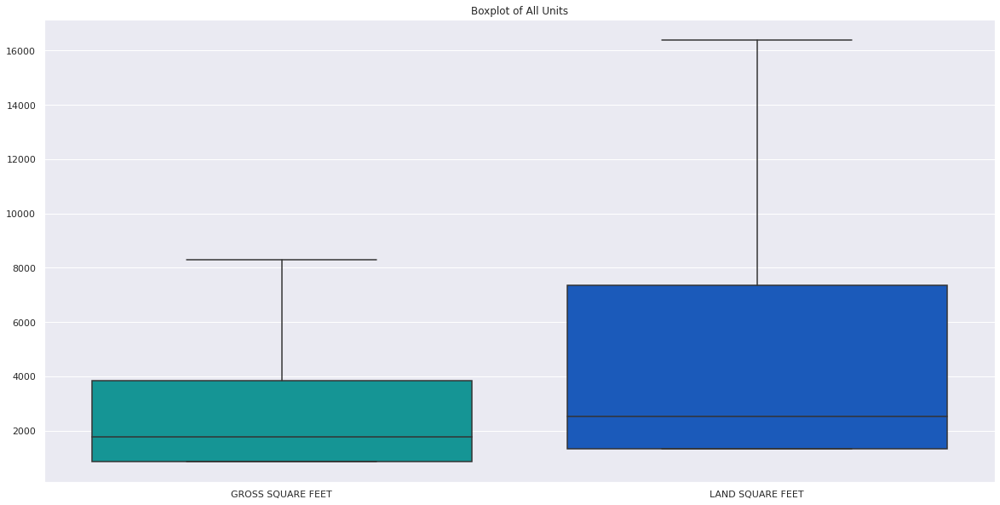

In [131]:
#Set the size of the plot
plt.figure(figsize=(20,10))

df_ = df[['GROSS SQUARE FEET', 'LAND SQUARE FEET']]
sns.boxplot(data=df_, palette="winter_r")
plt.title('Boxplot of All Units')
plt.show()

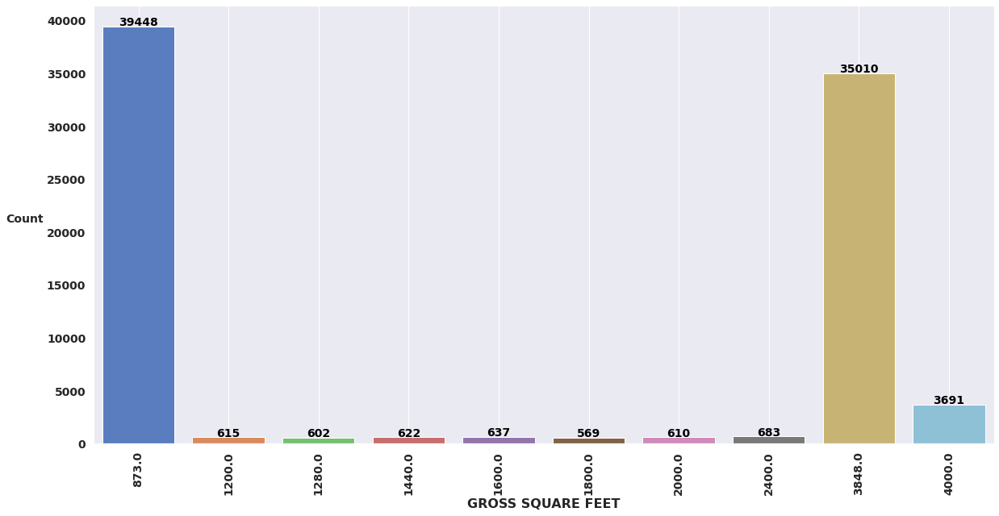

In [132]:
dist_plot('GROSS SQUARE FEET', 10)

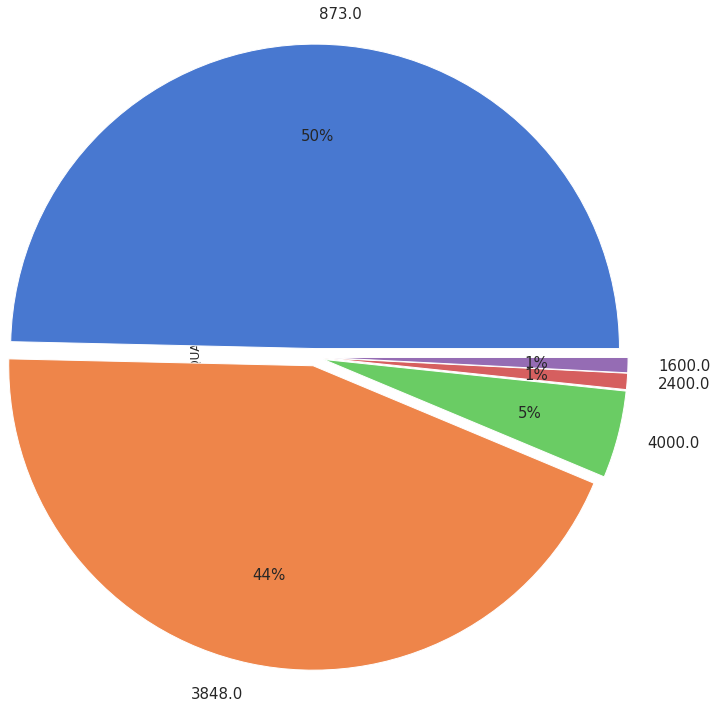

In [133]:
pie_plot('GROSS SQUARE FEET', 5)

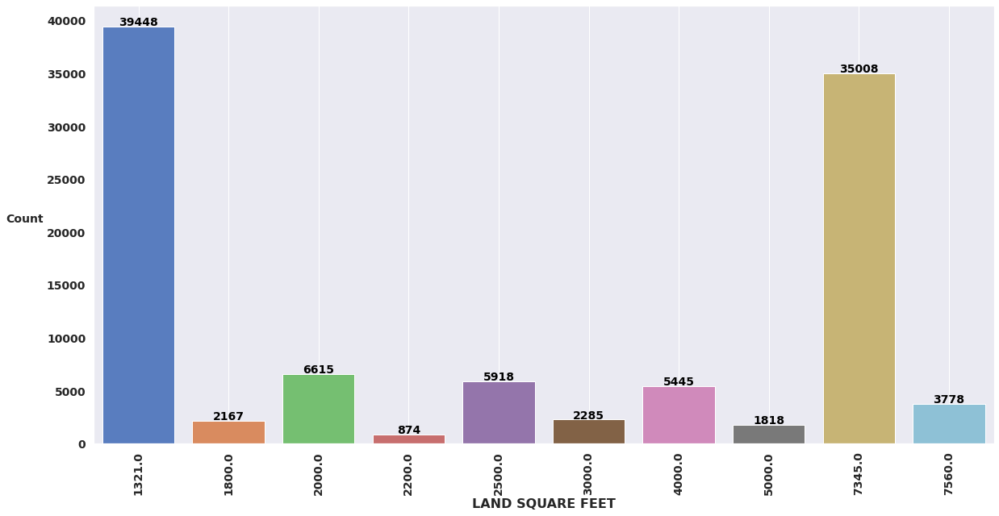

In [134]:
dist_plot('LAND SQUARE FEET', 10)

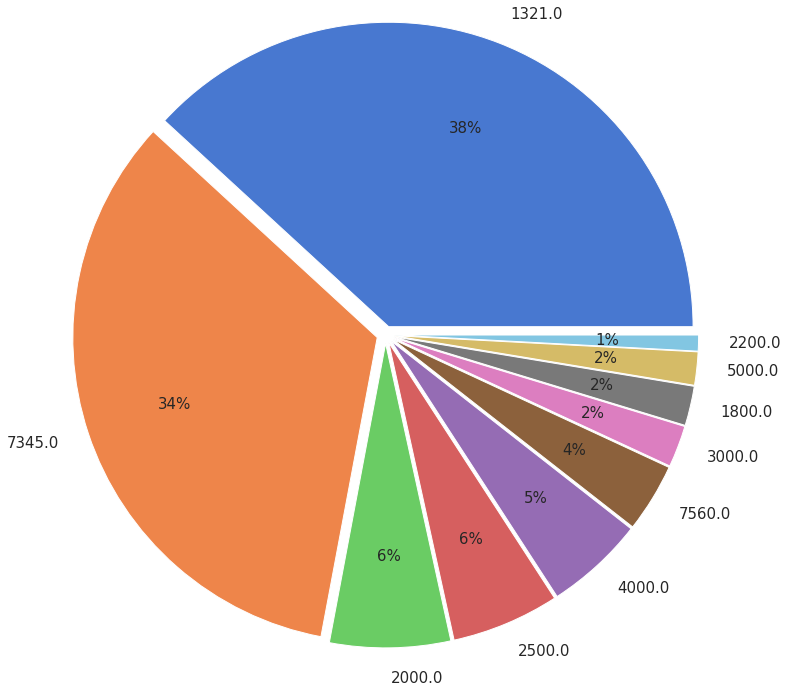

In [135]:
pie_plot('LAND SQUARE FEET', 10)

##In the end of this task
> Now We have `No Missing Data` which is so good for the next step

> No duplicates

> the data shape is `157785 Record` , `19 column`

In [136]:
df.shape

(157785, 19)

In [137]:
#checking for number of duplications
df.duplicated().sum()

0

In [138]:
# summary of the number of nulls and count the ratio of missing values
miss_number()

,Total missing,% missing
BOROUGH,0,0.0
COMMERCIAL UNITS,0,0.0
SALE PRICE,0,0.0
BUILDING CLASS AT TIME OF SALE,0,0.0
TAX CLASS AT TIME OF SALE,0,0.0
YEAR BUILT,0,0.0
GROSS SQUARE FEET,0,0.0
LAND SQUARE FEET,0,0.0
TOTAL UNITS,0,0.0
RESIDENTIAL UNITS,0,0.0


##BOROUGH

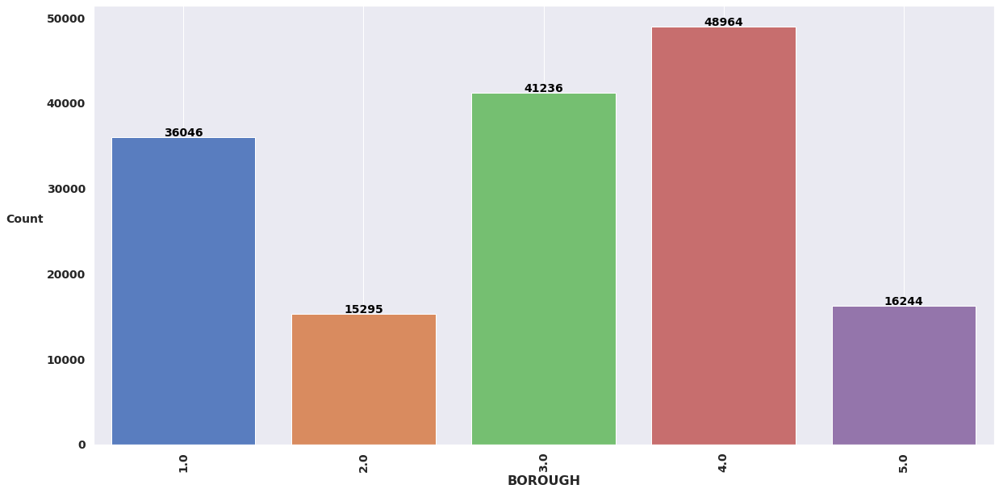

In [139]:
dist_plot('BOROUGH', len(df['BOROUGH'].value_counts()))

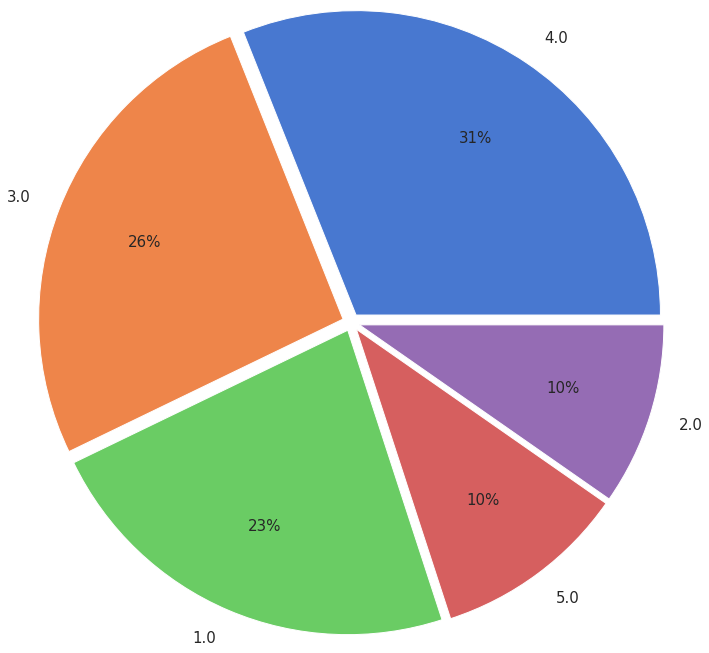

In [140]:
pie_plot('BOROUGH', len(df['BOROUGH'].value_counts()))

##NEIGHBORHOOD

In [141]:
df.head()

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,BUILDING CLASS AT PRESENT,ADDRESS,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
3581,1.0,GREENWICH VILLAGE-CENTRAL,43 CONDO OFFICE BUILDINGS,4,563.0,1008.0,RB,44 EAST 12TH STREET,10003.0,0.0,1.0,1.0,1321.0,873.0,1985.0,4.0,RB,488760.0,2018-08-09
3583,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,527.0,13.0,A4,26 DOWNING STREET,10014.0,1.0,0.0,1.0,1831.0,4650.0,2009.0,1.0,A4,19700000.0,2018-07-25
3584,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,582.0,31.0,A5,40 LEROY STREET,10014.0,1.0,0.0,1.0,1321.0,3650.0,1946.0,1.0,A5,11750000.0,2018-07-25
3585,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,583.0,53.0,A4,83 LEROY STREET,10014.0,1.0,0.0,1.0,2167.0,4368.0,1946.0,1.0,A4,12900000.0,2018-02-14
3587,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,585.0,23.0,A5,18 GROVE STREET,10014.0,1.0,0.0,1.0,1368.0,3840.0,1946.0,1.0,A5,24500000.0,2018-07-17


In [142]:
len(df['NEIGHBORHOOD'].value_counts())

253

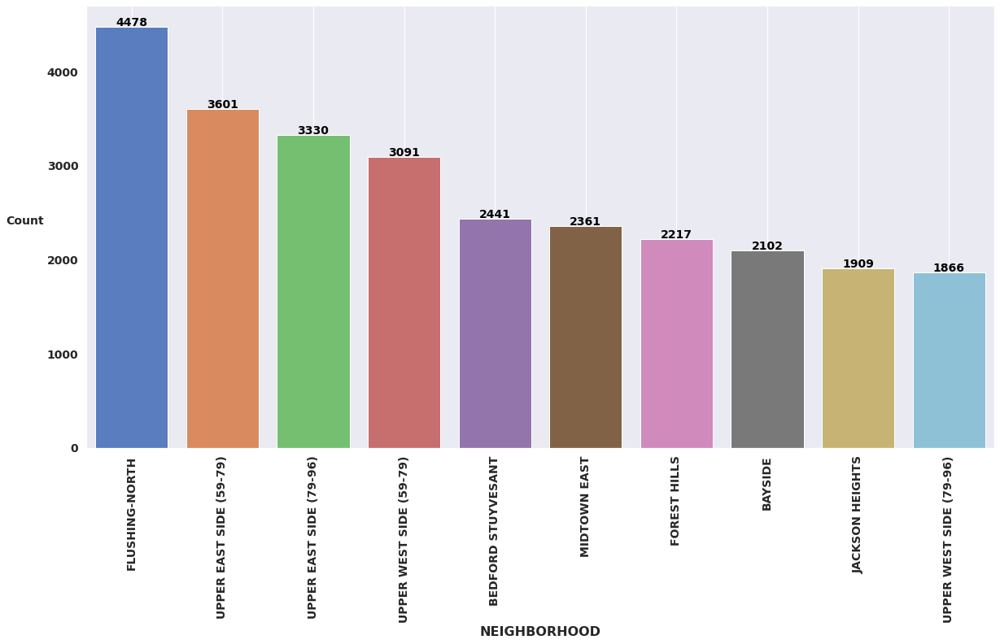

In [143]:
dist_plot('NEIGHBORHOOD', 10)

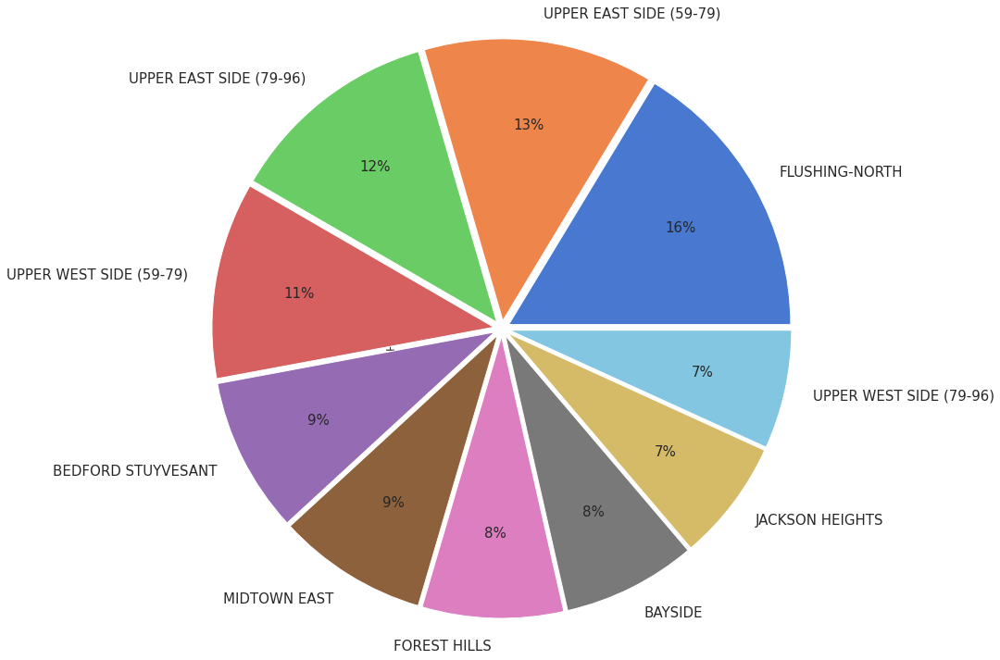

In [144]:
pie_plot('NEIGHBORHOOD', 10)

##BUILDING CLASS CATEGORY

In [145]:
df.head()

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,BUILDING CLASS AT PRESENT,ADDRESS,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
3581,1.0,GREENWICH VILLAGE-CENTRAL,43 CONDO OFFICE BUILDINGS,4,563.0,1008.0,RB,44 EAST 12TH STREET,10003.0,0.0,1.0,1.0,1321.0,873.0,1985.0,4.0,RB,488760.0,2018-08-09
3583,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,527.0,13.0,A4,26 DOWNING STREET,10014.0,1.0,0.0,1.0,1831.0,4650.0,2009.0,1.0,A4,19700000.0,2018-07-25
3584,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,582.0,31.0,A5,40 LEROY STREET,10014.0,1.0,0.0,1.0,1321.0,3650.0,1946.0,1.0,A5,11750000.0,2018-07-25
3585,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,583.0,53.0,A4,83 LEROY STREET,10014.0,1.0,0.0,1.0,2167.0,4368.0,1946.0,1.0,A4,12900000.0,2018-02-14
3587,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,585.0,23.0,A5,18 GROVE STREET,10014.0,1.0,0.0,1.0,1368.0,3840.0,1946.0,1.0,A5,24500000.0,2018-07-17


In [146]:
df['BUILDING CLASS CATEGORY'].value_counts()

01 ONE FAMILY DWELLINGS                       36018
10 COOPS - ELEVATOR APARTMENTS                29890
02 TWO FAMILY DWELLINGS                       26735
13 CONDOS - ELEVATOR APARTMENTS               24110
09 COOPS - WALKUP APARTMENTS                   6547
03 THREE FAMILY DWELLINGS                      6259
07 RENTALS - WALKUP APARTMENTS                 4198
04 TAX CLASS 1 CONDOS                          3308
15 CONDOS - 2-10 UNIT RESIDENTIAL              3264
17 CONDO COOPS                                 2566
12 CONDOS - WALKUP APARTMENTS                  2227
44 CONDO PARKING                               1941
05 TAX CLASS 1 VACANT LAND                     1576
22 STORE BUILDINGS                             1477
29 COMMERCIAL GARAGES                           875
14 RENTALS - 4-10 UNIT                          836
43 CONDO OFFICE BUILDINGS                       694
08 RENTALS - ELEVATOR APARTMENTS                635
21 OFFICE BUILDINGS                             634
31 COMMERCIA

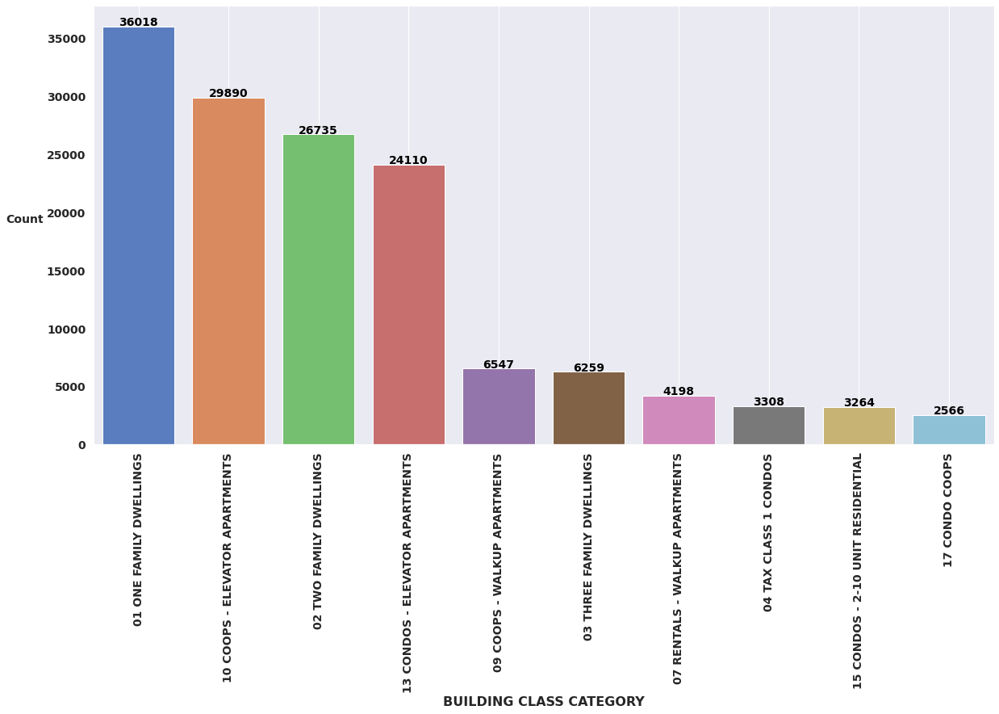

In [147]:
dist_plot('BUILDING CLASS CATEGORY', 10)

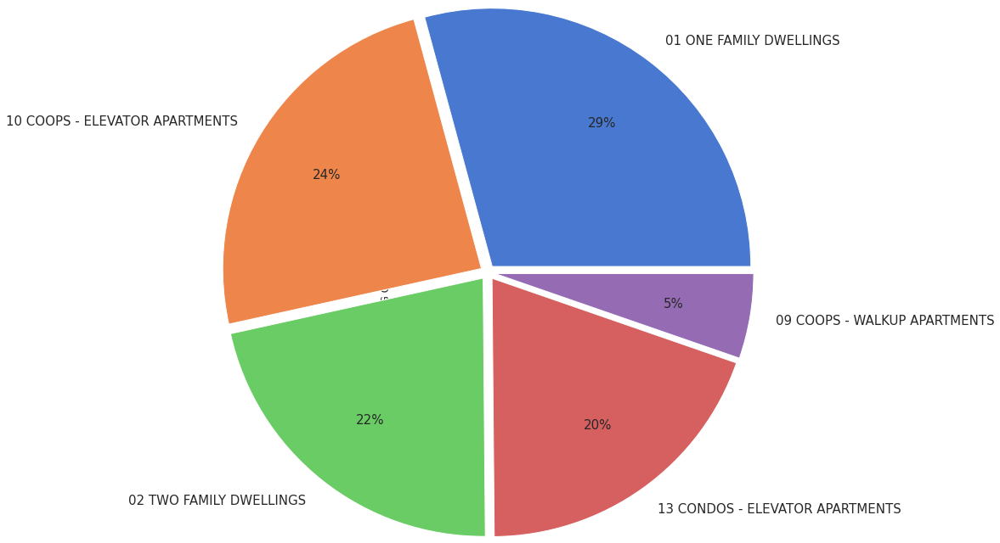

In [148]:
pie_plot('BUILDING CLASS CATEGORY', 5)

##BLOCK

In [149]:
#Checking for outliers boundaries
fig = px.histogram(df, x="BLOCK", marginal="box")
fig.show()

In [150]:
print(df['BLOCK'].quantile(0.10))
print(df['BLOCK'].quantile(0.95))

612.0
11990.0


> If we looking for this diagram we will find that
* min = 1
* q1 = 1309
* median = 3302
* q3 = 6369
* upper = 13959

> So I will Replace all values that's less than `1` with `1` and more than 11990 with `median` (`3302`)

In [151]:
df['BLOCK'] = np.where(df['BLOCK'] > 11990, 3302, df['BLOCK'])
df['BLOCK'] = np.where(df['BLOCK'] < 1, 1, df['BLOCK'])
df.describe()

,BOROUGH,BLOCK,LOT,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,SALE PRICE
count,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,1.577850e+05
mean,2.962386,3778.584447,381.744653,10812.039776,1.418557,0.291346,1.470171,3839.233533,2211.501759,1958.730849,1.644852,1.891020e+06
std,1.315847,2944.632574,667.824685,719.226413,0.969617,0.470110,0.940350,2670.906599,1308.655123,26.974901,0.757199,1.469423e+07
min,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1321.000000,873.000000,1925.000000,1.000000,1.000000e+00
25%,2.000000,1309.000000,21.000000,10304.000000,1.000000,0.000000,1.000000,1321.000000,873.000000,1946.000000,1.000000,4.250000e+05
50%,3.000000,3302.000000,50.000000,11207.000000,1.000000,0.000000,1.000000,2520.000000,1776.000000,1946.000000,2.000000,6.800000e+05
75%,4.000000,5713.000000,1002.000000,11357.000000,2.000000,1.000000,2.000000,7345.000000,3848.000000,1969.000000,2.000000,1.150000e+06
max,5.000000,11990.000000,9116.000000,11697.000000,3.000000,2.000000,3.000000,16376.000000,8310.000000,2021.000000,4.000000,2.397502e+09


In [152]:
df['BLOCK'].value_counts()

3302.0    7897
1171.0     518
16.0       413
5953.0     369
3944.0     344
          ... 
8586.0       1
8626.0       1
8568.0       1
8731.0       1
6455.0       1
Name: BLOCK, Length: 10753, dtype: int64

In [153]:
#Checking for outliers boundaries
fig = px.histogram(df, x="BLOCK", marginal="box")
fig.show()

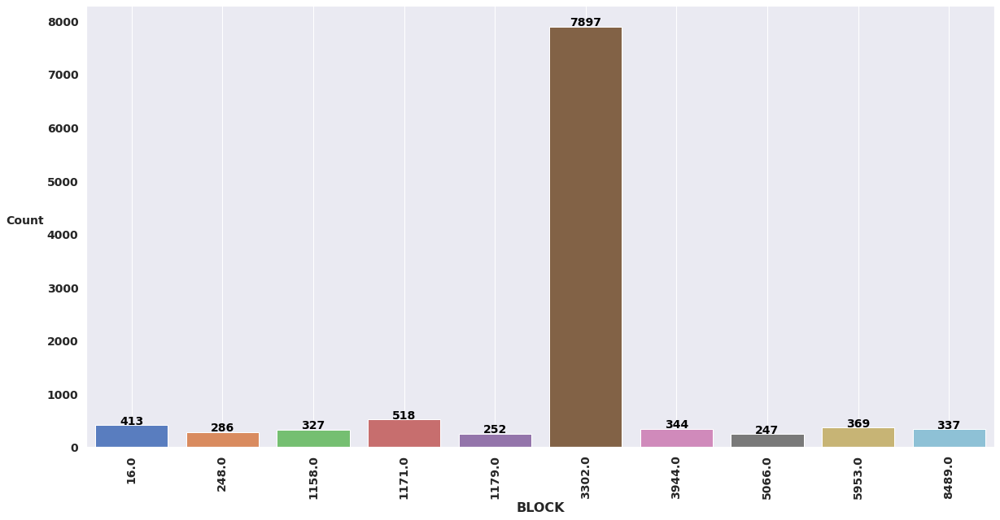

In [154]:
dist_plot('BLOCK', 10)

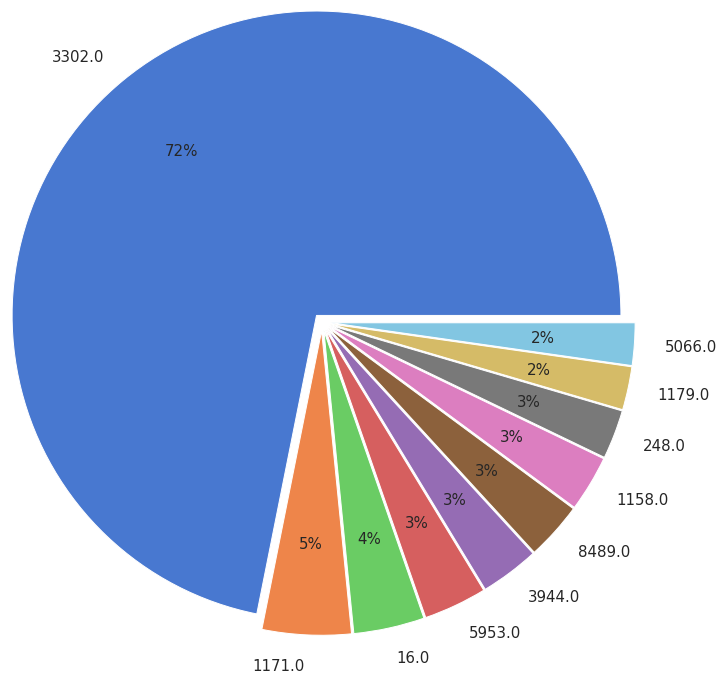

In [155]:
pie_plot('BLOCK', 10)

##LOT

In [156]:
#Checking for outliers boundaries
fig = px.histogram(df, x="LOT", marginal="box")
fig.show()

In [157]:
print(df['LOT'].quantile(0.10))
print(df['LOT'].quantile(0.95))

7.0
1401.0


> If we looking for this diagram we will find that
* min = 1
* q1 = 21
* median = 50
* q3 = 1002
* upper = 2473

> So I will Replace all values that's less than `7` with `7` and more than `1401` with `1401`

In [158]:
df['LOT'] = np.where(df['LOT'] > 1401, 1401, df['LOT'])
df['LOT'] = np.where(df['LOT'] < 7, 7, df['LOT'])
df.describe()

,BOROUGH,BLOCK,LOT,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,SALE PRICE
count,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,157785.000000,1.577850e+05
mean,2.962386,3778.584447,340.035365,10812.039776,1.418557,0.291346,1.470171,3839.233533,2211.501759,1958.730849,1.644852,1.891020e+06
std,1.315847,2944.632574,497.105725,719.226413,0.969617,0.470110,0.940350,2670.906599,1308.655123,26.974901,0.757199,1.469423e+07
min,1.000000,1.000000,7.000000,0.000000,0.000000,0.000000,0.000000,1321.000000,873.000000,1925.000000,1.000000,1.000000e+00
25%,2.000000,1309.000000,21.000000,10304.000000,1.000000,0.000000,1.000000,1321.000000,873.000000,1946.000000,1.000000,4.250000e+05
50%,3.000000,3302.000000,50.000000,11207.000000,1.000000,0.000000,1.000000,2520.000000,1776.000000,1946.000000,2.000000,6.800000e+05
75%,4.000000,5713.000000,1002.000000,11357.000000,2.000000,1.000000,2.000000,7345.000000,3848.000000,1969.000000,2.000000,1.150000e+06
max,5.000000,11990.000000,1401.000000,11697.000000,3.000000,2.000000,3.000000,16376.000000,8310.000000,2021.000000,4.000000,2.397502e+09


In [159]:
df['LOT'].value_counts()

7.0       17303
1401.0     7977
23.0       1787
50.0       1741
10.0       1725
          ...  
662.0         1
764.0         1
784.0         1
939.0         1
555.0         1
Name: LOT, Length: 1170, dtype: int64

In [160]:
#Checking for outliers boundaries
fig = px.histogram(df, x="LOT", marginal="box")
fig.show()

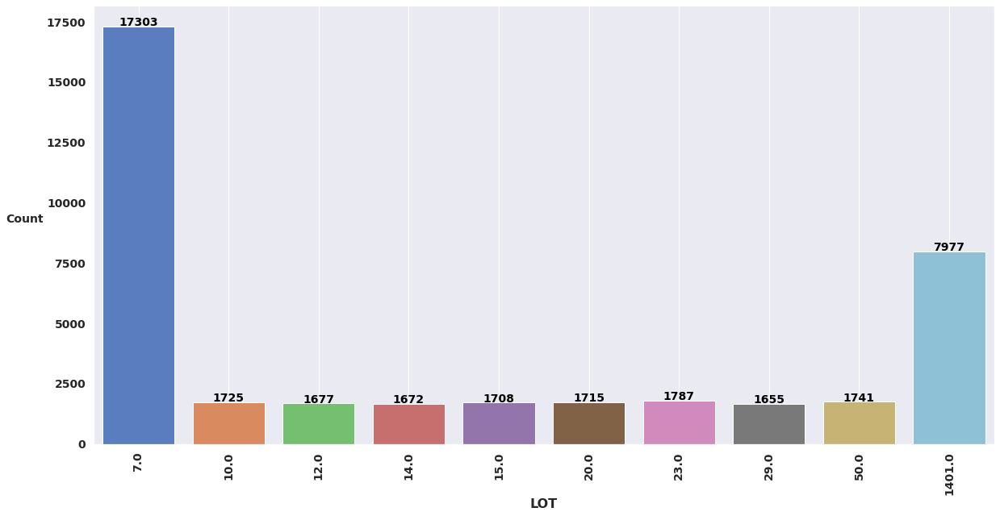

In [161]:
dist_plot('LOT', 10)

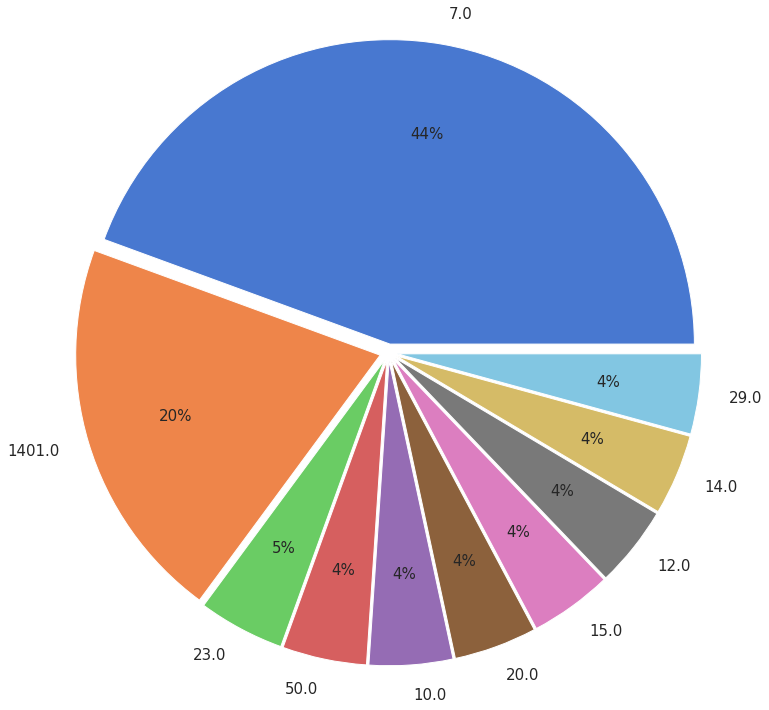

In [162]:
pie_plot('LOT', 10)

#Task 2: Data exploration using data visualization. Raise two questions that can be answered by performing data visualization. Briefely mention why you think this question would be interesting to whom (who is your audience). Think about the EDA principals.

##Question 2.1: {put your raised question here}

###what are the number of units are sold for each month?

> In the begining I want to create `[MONTH SELL`,`YEAR SELL]` Column to know the distribution of all sells for all months in every year

> This question is important for real estate companies to know the best time of the year to buy buildings to save more money and to know the best time of the year to sell buildings to make a lot of money

> **who is your audience:** any company or any person want to buy an apartment

In [163]:
# convert it into date type
df['SALE DATE'] = pd.to_datetime(df['SALE DATE'])

# create two new columns
df['YEAR SELL'] = (df['SALE DATE']).dt.year
df['MONTH SELL']= (df['SALE DATE']).dt.month

Text(0.5, 0.9, 'Monthly Sales')

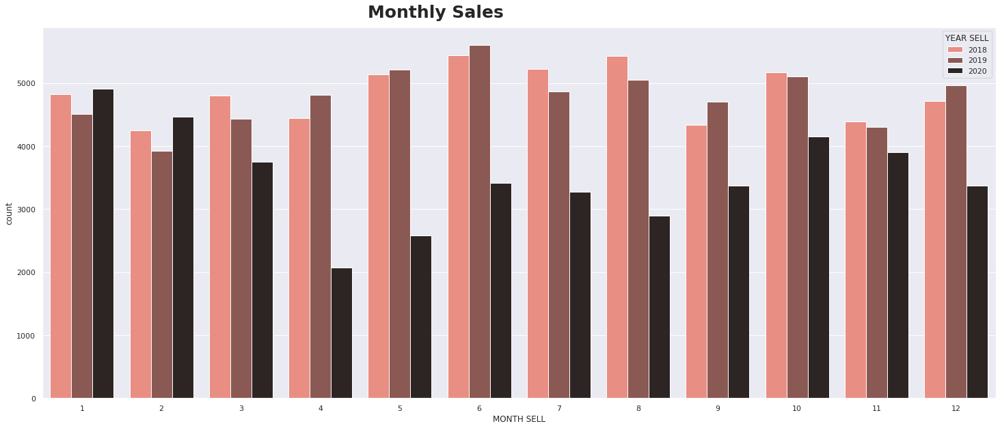

In [164]:
# Housing Sales per Borough by Months
sns.set(palette="muted", color_codes=True)
plt.figure(figsize=(25,10))
sns.countplot('MONTH SELL', hue='YEAR SELL', data=df, palette='dark:salmon_r')
plt.figtext(.5,.9,"Monthly Sales", fontsize=25, fontweight='bold', fontname='helvetica', ha='right') #title formatting

> So As we see from the previous results we can get that 
* The `Maximum` value is `around 5500` Data ==> `[Month : 6, Year : 2019]`
* The `Minimum` value is `around 2000` Data ==> `[Month : 4, Year : 2020]`

##Question 2.2: {put your raised question here.}

### **What is the `new building` at the `lowest selling price`?**

> **This question is very important for everyone because all people are looking for new homes with low budget**

> **who is your audience:** Who wants to buy a new building or apartment

> in the begining I will create a new column with the age of every building by substract the number of current year `[2022]` from all `YEAR BUILT` values

In [165]:
df['AGE'] = 2022 - df['YEAR BUILT'] 
df.head()

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,BUILDING CLASS AT PRESENT,ADDRESS,ZIP CODE,RESIDENTIAL UNITS,...,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE,YEAR SELL,MONTH SELL,AGE
3581,1.0,GREENWICH VILLAGE-CENTRAL,43 CONDO OFFICE BUILDINGS,4,563.0,1008.0,RB,44 EAST 12TH STREET,10003.0,0.0,...,1321.0,873.0,1985.0,4.0,RB,488760.0,2018-08-09,2018,8,37.0
3583,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,527.0,13.0,A4,26 DOWNING STREET,10014.0,1.0,...,1831.0,4650.0,2009.0,1.0,A4,19700000.0,2018-07-25,2018,7,13.0
3584,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,582.0,31.0,A5,40 LEROY STREET,10014.0,1.0,...,1321.0,3650.0,1946.0,1.0,A5,11750000.0,2018-07-25,2018,7,76.0
3585,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,583.0,53.0,A4,83 LEROY STREET,10014.0,1.0,...,2167.0,4368.0,1946.0,1.0,A4,12900000.0,2018-02-14,2018,2,76.0
3587,1.0,GREENWICH VILLAGE-WEST,01 ONE FAMILY DWELLINGS,1,585.0,23.0,A5,18 GROVE STREET,10014.0,1.0,...,1368.0,3840.0,1946.0,1.0,A5,24500000.0,2018-07-17,2018,7,76.0


> Draw scatter plot for all `AGE` values with `SALE PRICE` values

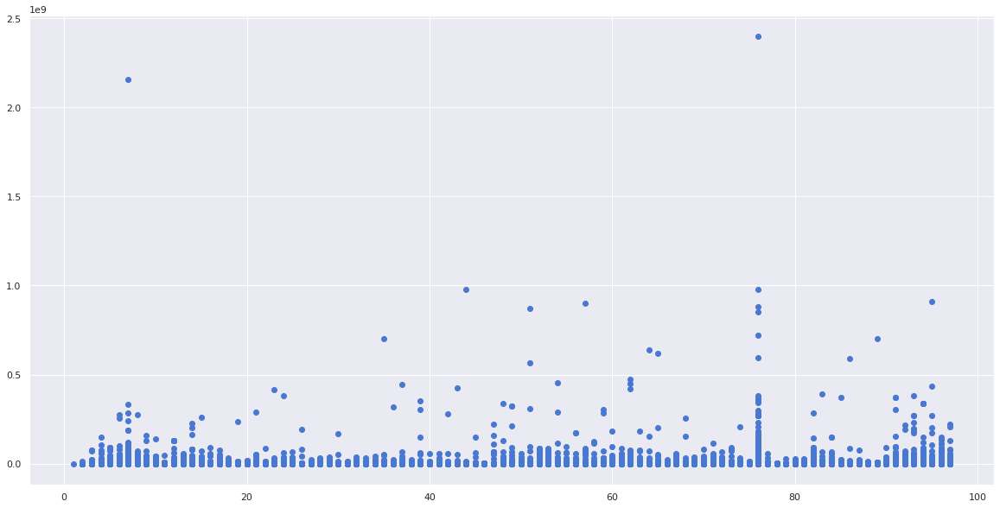

In [166]:
sns.set_style('darkgrid')
plt.figure(figsize=(20,10))
plt.scatter(x = df['AGE'], y = df['SALE PRICE'])

> We couldn't find specific which one is the less one

> so I will use nsmallest method to found the the lower values for `SALE PRICE` and `AGE` column at the same time to answer our question

In [167]:
df_new = df.nsmallest(20, ["SALE PRICE", 'AGE'])
df_new

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,BUILDING CLASS AT PRESENT,ADDRESS,ZIP CODE,RESIDENTIAL UNITS,...,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE,YEAR SELL,MONTH SELL,AGE
3787,2.0,MOTT HAVEN/PORT MORRIS,29 COMMERCIAL GARAGES,2,2268.0,27.0,D7,345 ST ANNS AVENUE,10454.0,1.0,...,7560.0,873.0,2019.0,4.0,G7,1.0,2019-06-27,2019,6,3.0
5971,2.0,WILLIAMSBRIDGE,10 COOPS - ELEVATOR APARTMENTS,2,4671.0,7.0,D4,839-843 TILDEN STREET,10467.0,3.0,...,7345.0,3848.0,2018.0,2.0,D4,1.0,2020-10-15,2020,10,4.0
7194,2.0,WESTCHESTER,05 TAX CLASS 1 VACANT LAND,2,3827.0,215.0,D1,1118 HAVEMEYER AVENUE,10462.0,1.0,...,7560.0,4000.0,2018.0,1.0,V0,1.0,2018-08-22,2018,8,4.0
22677,3.0,WILLIAMSBURG-EAST,28 COMMERCIAL CONDOS,4,3127.0,1001.0,R5,40 DEBEVOISE STREET,11206.0,0.0,...,1321.0,873.0,2018.0,4.0,R5,1.0,2018-05-23,2018,5,4.0
5750,3.0,BROWNSVILLE,31 COMMERCIAL VACANT LAND,2,3566.0,7.0,D7,3 LIVONIA AVENUE,11212.0,1.0,...,7560.0,4000.0,2018.0,4.0,V1,1.0,2018-06-28,2018,6,4.0
15746,3.0,PROSPECT HEIGHTS,28 COMMERCIAL CONDOS,4,1118.0,1005.0,R5,"38 SIXTH AVENUE, HCA",11217.0,1.0,...,7345.0,3848.0,2016.0,4.0,R5,1.0,2020-01-31,2020,1,6.0
15747,3.0,PROSPECT HEIGHTS,28 COMMERCIAL CONDOS,4,1118.0,1006.0,R5,"38 SIXTH AVENUE, HCB",11217.0,1.0,...,7345.0,3848.0,2016.0,4.0,R5,1.0,2020-01-31,2020,1,6.0
15749,3.0,PROSPECT HEIGHTS,44 CONDO PARKING,4,1118.0,1007.0,RG,"38 SIXTH AVENUE, GARAG",11217.0,1.0,...,7345.0,3848.0,2016.0,4.0,RG,1.0,2020-01-31,2020,1,6.0
15658,3.0,PROSPECT HEIGHTS,11 SPECIAL CONDO BILLING LOTS,2,1118.0,1008.0,RR,"38 SIXTH AVENUE, LIHTC",11217.0,1.0,...,7560.0,4000.0,2016.0,2.0,RR,1.0,2020-01-31,2020,1,6.0
15659,3.0,PROSPECT HEIGHTS,11 SPECIAL CONDO BILLING LOTS,2,1118.0,1009.0,RR,"38 SIXTH AVENUE, MIU",11217.0,1.0,...,7560.0,4000.0,2016.0,2.0,RR,1.0,2020-01-31,2020,1,6.0


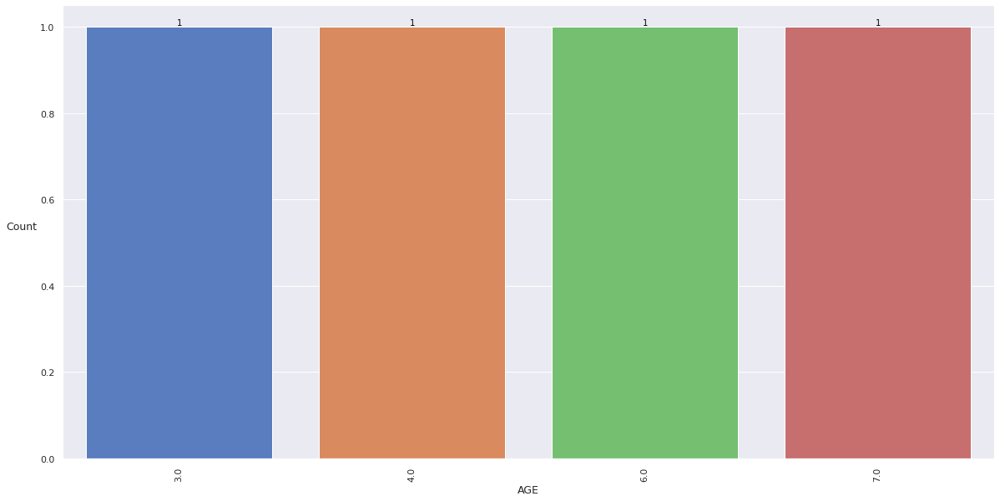

In [168]:
plt.figure(figsize=(20,10)) #figsize must be applied before plotting the graph
plt.xticks(rotation='vertical') #text rotation for readability
plot_needed_ind = sns.barplot(x=df_new['AGE'], y=df_new['SALE PRICE'])

plt.xlabel('AGE', fontsize=12.5)
plt.ylabel('Count', rotation=0, ha='right', fontsize=12.5)

for patch in plot_needed_ind.patches:
    plot_needed_ind.annotate("%.0f" % patch.get_height(), (patch.get_x() + patch.get_width() / 2., patch.get_height()),
                 ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                 textcoords='offset points')

plt.show()

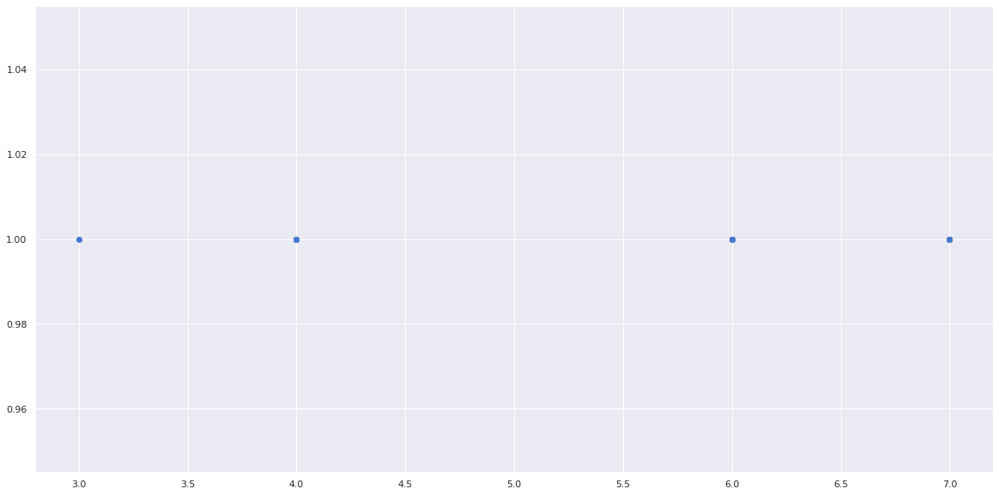

In [169]:
sns.set_style('darkgrid')
plt.figure(figsize=(20,10))
plt.scatter(x = df_new['AGE'], y = df_new['SALE PRICE'])

> As we can see, From all of these results the answer is 
* The minimum `age` is `3` and the minimum sale price is `1`

#Task 3: Data Exploration via Statistical Test Raise one question that can be answered by performing hypothesis test. Briefely mention why you think this question would be interesting to whom (who is your audience). Also mention which statistical test you would choose and why.

**`Null hypothesis:`** The Average `SALE PRICE` for `BOROUGH` number `1` is the `lower` average 

**`Alternative hypothesis:`** The Average `SALE PRICE` for `BOROUGH` number `1` is the `highest` average 

> this hypothesis is important for all people to know which BOROUGH has the highest `SALE PRICE` to Avoid it if they are looking for any appartment or building with low average SALE

> and as we know if any place has a high `PRICE` that's may be the high quality place so there are another people looking for the good places and doesn't look for how much it's

In [201]:

d3 = pd.DataFrame(df.groupby(['BOROUGH']).mean()).reset_index()
d3.rename(columns = {"BOROUGH":"borough"},inplace = True)
d3.rename(columns = {"SALE PRICE":"salePrice"},inplace = True)


b_1_price = df[df['BOROUGH'] == 1]['SALE PRICE'].mean()
b_2_price = df[df['BOROUGH'] == 2]['SALE PRICE'].mean()
b_3_price = df[df['BOROUGH'] == 3]['SALE PRICE'].mean()
b_4_price = df[df['BOROUGH'] == 4]['SALE PRICE'].mean()
b_5_price = df[df['BOROUGH'] == 5]['SALE PRICE'].mean()


d3['salePrice'][0] = b_1_price
d3['salePrice'][1] = b_2_price
d3['salePrice'][2] = b_3_price
d3['salePrice'][3] = b_4_price
d3['salePrice'][4] = b_5_price

# For visualization purposes, we replace borough numbering with their string names.
d3['borough'][d3.borough == 1] = 'Manhattan'
d3['borough'][d3.borough == 2] = 'Bronx'
d3['borough'][d3.borough == 3] = 'Brooklyn'
d3['borough'][d3.borough == 4] = 'Queens'
d3['borough'][d3.borough == 5] = 'Staten Island'

colors = ['green', 'purple',  'blue', 'yellow', 'cyan']

total = d3.salePrice.sum()
trace0 = go.Scatter( x=d3.borough, y=d3.salePrice, mode='markers',
    marker=dict( size=[((x/total)*300) for x in d3.salePrice], color=colors))

data = [trace0]
layout = go.Layout(title='Average SALE PRICE for every Borough',
    xaxis=dict(title='Borough', gridcolor='rgb(255, 255, 255)',),
    yaxis=dict(title='SALE PRICE', gridcolor='rgb(255, 255, 255)',),
    paper_bgcolor='rgb(243, 243, 243)', plot_bgcolor='rgb(243, 243, 243)')

fig = go.Figure(data=data, layout=layout)
fig.show(renderer="colab")


> As we can see, the first `BOROUGH(1) [Manhattan]` is the **`highest BOROUGH`** which it's `look like` my `hypothesis`

###hypothesis test

> I have Two Samples **`[BOROUGH, SALE PRICE]`** 

> So i'am in test two 
 
>`(PAIRD SAMPLES)`==> not paird sample because I have sample from `BOROUGH` and from `SALE PRICE`

> `Equal Variance` ==> No

> So this test is **`ANOVA TEST`**`

> With ANOVA, you get to discover obvious differences between the means of your independent features. Upon getting a clearer picture of the differences.

> you can understand how each of them connects to your dependent variable. You can see what are the influencing factors for the relationship.

In [195]:
b_Manhatten_price = df[df['BOROUGH'] == 1]['SALE PRICE']
b_Bronx_price = df[df['BOROUGH'] == 2]['SALE PRICE']
b_Brooklyn_price = df[df['BOROUGH'] == 3]['SALE PRICE']
b_Queens_price = df[df['BOROUGH'] == 4]['SALE PRICE']
b_Staten_Island_price = df[df['BOROUGH'] == 5]['SALE PRICE']

In [197]:
print('Manhatten : ',b_Manhatten_price.mean())
print('Bronx : ' , b_Bronx_price.mean())
print('Brooklyn : ',b_Brooklyn_price.mean())
print('Queens : ',b_Queens_price.mean())
print('Staten_Island : ',b_Staten_Island_price.mean())

Manhatten :  4352247.570354547
Bronx :  1318013.6351748938
Brooklyn :  1514128.2735473858
Queens :  997459.5315946409
Staten_Island :  619199.6596897315


In [200]:
stat, p = f_oneway(b_Manhatten_price, b_Bronx_price, b_Brooklyn_price,b_Queens_price ,b_Staten_Island_price)

print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably the same distribution')
else:
	print('Probably different distributions')


stat=344.068, p=0.000
Probably different distributions


> So it's less than the average so it's wrong and my hypothis as i proved from the diagram is true

#Task 4: Feature Engineering. If we would like to predict the house sale price. Analyze the scale of each attribute and determine which ones you would transfer (e.g., cateogorical features). Discuss how you plan to select important features.

In [ ]:
#general summary of dataset
df.describe(include='all').transpose()

,count,unique,top,freq,first,last,mean,std,min,25%,50%,75%,max
BOROUGH,157785.0,NaN,NaN,NaN,NaT,NaT,2.962386,1.315847,1.0,2.0,3.0,4.0,5.0
NEIGHBORHOOD,157785,253,FLUSHING-NORTH,4478,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BUILDING CLASS CATEGORY,157785,46,01 ONE FAMILY DWELLINGS,36018,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TAX CLASS AT PRESENT,157785,10,1,68894,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BLOCK,157785.0,NaN,NaN,NaN,NaT,NaT,3778.584447,2944.632574,1.0,1309.0,3302.0,5713.0,11990.0
LOT,157785.0,NaN,NaN,NaN,NaT,NaT,340.035365,497.105725,7.0,21.0,50.0,1002.0,1401.0
BUILDING CLASS AT PRESENT,157785,174,D4,29378,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ADDRESS,157785,146126,184 KENT AVENUE,72,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ZIP CODE,157785.0,NaN,NaN,NaN,NaT,NaT,10812.039776,719.226413,0.0,10304.0,11207.0,11357.0,11697.0
RESIDENTIAL UNITS,157785.0,NaN,NaN,NaN,NaT,NaT,1.418557,0.969617,0.0,1.0,1.0,2.0,3.0


## convert all `categorical` columns to `numerical`

###NEIGHBORHOOD

In [ ]:
len(df['NEIGHBORHOOD'].unique())

253

> As we can see, We have `253` unique value so I will not using one hot encoding may be use Labelencoder or target encoding

> in this column I will use `Label encoding`

In [ ]:
encoder = LabelEncoder()
df['NEIGHBORHOOD'] = encoder.fit_transform(df['NEIGHBORHOOD'])

In [ ]:
df['NEIGHBORHOOD'].unique()

array([105, 106,  98, 109,  79,  77,  72,  46,  84, 150, 149, 141, 138,
       151, 111, 110, 121, 112, 134, 132, 127,  41,   2,  45,  42, 235,
       236, 232, 230, 231, 226, 208, 213, 227, 159, 196, 154, 228, 229,
        30,  39,  43,  14,  19,  29,  90, 113,  78, 120, 130,  57,  71,
        58, 209, 221,  12,  10, 155, 194, 181, 178, 179, 180, 203, 146,
       156, 131, 158, 157, 249, 241, 238, 234, 233,  49,  44, 173, 104,
       101, 128,  97,  94,  92, 152, 143, 153, 171, 160, 139, 140,  80,
        81,  70,  83,  85,  82, 205, 204, 220, 242, 214, 176, 174, 186,
       177, 188,  24, 172,  23,  21, 244, 243, 252,  20, 247, 245, 124,
        68,  37,  32,  31,  35,  34,  27,  15,  67,  66,  55,  51,  50,
        59,  38,  47,  60,  65,  11,   9, 216, 219, 215, 240, 248, 251,
       115,   0, 168, 147, 161, 175, 145, 189, 187, 123, 125, 122, 129,
       126, 137, 133, 135, 212, 193, 190, 198, 195, 211, 207,  56,  64,
        69,  52,  36,  28,  76,  73,  86,  87,  88,   8,  13,   

###BUILDING CLASS CATEGORY

In [ ]:
len(df['BUILDING CLASS CATEGORY'].unique())

46

> As we can see, We have `46` unique value so it's may be to using one hot encoding ,Labelencoder or target encoding

> in this column I will use `Target encoding`

In [ ]:
encoder = TargetEncoder()
df['BUILDING CLASS CATEGORY'] = encoder.fit_transform(df['BUILDING CLASS CATEGORY'], df['SALE PRICE'])

In [ ]:
df['BUILDING CLASS CATEGORY'].unique()

array([3.13310669e+07, 7.23069772e+05, 2.63411009e+07, 9.91921335e+05,
       3.80968339e+07, 6.84746130e+06, 1.12412608e+06, 6.47623453e+05,
       3.35016366e+06, 9.09231795e+05, 2.94533284e+06, 1.43568971e+06,
       2.57143799e+06, 2.31735223e+06, 1.09959989e+06, 8.12732597e+05,
       2.58665796e+07, 3.28397990e+06, 1.18652714e+07, 7.53614027e+05,
       1.77949701e+07, 1.02357400e+06, 9.72152877e+07, 1.47241108e+06,
       2.72194049e+07, 9.90831964e+06, 8.15462860e+06, 6.69691599e+06,
       1.65212750e+07, 5.30807655e+06, 1.79146666e+07, 4.53060386e+06,
       1.24691558e+07, 1.20821071e+08, 3.48584880e+06, 7.73481125e+06,
       1.25100135e+07, 5.95960206e+06, 1.12244626e+08, 8.13222085e+06,
       7.96004498e+05, 7.78187765e+05, 6.07766040e+05, 1.10145294e+06,
       3.34818535e+07, 1.89102016e+06])

###TAX CLASS AT PRESENT

In [ ]:
len(df['TAX CLASS AT PRESENT'].unique())

10

> As we can see, We have `10` unique value so I will not using one hot encoding may be use Labelencoder or target encoding

> in this column I will use `one hot encoding`

In [ ]:
df = pd.get_dummies(df, columns=['TAX CLASS AT PRESENT'])

In [ ]:
df

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,BLOCK,LOT,BUILDING CLASS AT PRESENT,ADDRESS,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,...,TAX CLASS AT PRESENT_1,TAX CLASS AT PRESENT_1A,TAX CLASS AT PRESENT_1B,TAX CLASS AT PRESENT_1C,TAX CLASS AT PRESENT_1D,TAX CLASS AT PRESENT_2,TAX CLASS AT PRESENT_2A,TAX CLASS AT PRESENT_2B,TAX CLASS AT PRESENT_2C,TAX CLASS AT PRESENT_4
3581,1.0,105,3.133107e+07,563.0,1008.0,RB,44 EAST 12TH STREET,10003.0,0.0,1.0,...,0,0,0,0,0,0,0,0,0,1
3583,1.0,106,7.230698e+05,527.0,13.0,A4,26 DOWNING STREET,10014.0,1.0,0.0,...,1,0,0,0,0,0,0,0,0,0
3584,1.0,106,7.230698e+05,582.0,31.0,A5,40 LEROY STREET,10014.0,1.0,0.0,...,1,0,0,0,0,0,0,0,0,0
3585,1.0,106,7.230698e+05,583.0,53.0,A4,83 LEROY STREET,10014.0,1.0,0.0,...,1,0,0,0,0,0,0,0,0,0
3587,1.0,106,7.230698e+05,585.0,23.0,A5,18 GROVE STREET,10014.0,1.0,0.0,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
240,5.0,4,7.230698e+05,5740.0,190.0,A5,49 BIANCA COURT,10312.0,1.0,0.0,...,1,0,0,0,0,0,0,0,0,0
241,5.0,4,7.230698e+05,5741.0,41.0,A5,142 ILYSSA WAY,10312.0,1.0,0.0,...,1,0,0,0,0,0,0,0,0,0
242,5.0,4,7.230698e+05,5741.0,83.0,A5,240 ILYSSA WAY,10312.0,1.0,0.0,...,1,0,0,0,0,0,0,0,0,0
243,5.0,4,7.230698e+05,5741.0,98.0,A5,278 ILYSSA WAY,10312.0,1.0,0.0,...,1,0,0,0,0,0,0,0,0,0


###BUILDING CLASS AT PRESENT

In [ ]:
len(df['BUILDING CLASS AT PRESENT'].unique())

174

> As we can see, We have `174` unique value so I will not using one hot encoding may be use Labelencoder or target encoding

> in this column I will use `Target encoding`

In [ ]:
encoder = TargetEncoder()
df['BUILDING CLASS AT PRESENT'] = encoder.fit_transform(df['BUILDING CLASS AT PRESENT'], df['SALE PRICE'])

In [ ]:
df['BUILDING CLASS AT PRESENT'].unique()

array([3.12138907e+07, 5.10572951e+06, 5.90472582e+05, 7.66342762e+05,
       1.38463963e+06, 1.87393470e+07, 9.91921335e+05, 1.86239556e+07,
       4.72804900e+06, 1.11731936e+06, 9.27149542e+05, 3.09117340e+06,
       7.85293815e+06, 1.41364302e+06, 1.90192324e+06, 8.28020192e+05,
       1.48562935e+06, 9.62792915e+05, 9.22557505e+05, 3.83019491e+06,
       1.43861019e+06, 2.82032283e+06, 2.31720582e+06, 1.07964231e+06,
       8.11691170e+05, 4.59493504e+06, 1.44611287e+07, 2.90100104e+07,
       2.24474394e+06, 3.17064215e+06, 1.16541024e+07, 2.44434582e+07,
       2.11807090e+07, 4.68130745e+06, 3.15495530e+06, 1.37404617e+06,
       5.68415869e+05, 6.98491080e+05, 2.29532904e+07, 2.00777310e+07,
       1.24380383e+06, 8.69185126e+05, 1.14267420e+08, 1.45191883e+06,
       2.65774977e+06, 1.00198040e+08, 2.16652376e+07, 5.96016388e+06,
       3.68400516e+07, 5.16052447e+07, 6.54516525e+07, 2.53475956e+07,
       1.89102016e+06, 4.47442723e+07, 1.00873438e+07, 8.71336500e+06,
      

###ADDRESS

In [ ]:
len(df['ADDRESS'].unique())

146126

> As we can see, We have `146126` unique value so I will not using one hot encoding may be use Labelencoder or target encoding

> but at all i will drop this column becasue there are another columns represent the same information so I will drop this column

In [ ]:
df.drop(['ADDRESS'], axis = 1, inplace = True)

###BUILDING CLASS AT TIME OF SALE

In [ ]:
len(df['BUILDING CLASS AT TIME OF SALE'].unique())

320

> As we can see, We have `320` unique value so I will not using one hot encoding may be use Labelencoder or target encoding

> in this column I will use `Target encoding`

In [ ]:
encoder = TargetEncoder()
df['BUILDING CLASS AT TIME OF SALE'] = encoder.fit_transform(df['BUILDING CLASS AT TIME OF SALE'], df['SALE PRICE'])

In [ ]:
df['BUILDING CLASS AT TIME OF SALE'].unique()

array([1.48094291e+07, 4.97071964e+06, 5.81954944e+05, 7.45167836e+05,
       1.07897888e+06, 1.87393470e+07, 1.01776524e+06, 1.97549902e+07,
       4.66109487e+06, 1.04503478e+06, 1.89102016e+06, 3.60334432e+06,
       8.69867639e+06, 1.29955943e+06, 1.68589737e+06, 7.97822097e+05,
       1.28697916e+06, 9.26734467e+05, 8.72877124e+05, 2.76838511e+06,
       1.58010856e+06, 3.26920883e+06, 1.85780283e+06, 8.27829764e+05,
       5.59671851e+05, 4.11781081e+06, 1.51564112e+07, 2.28182024e+07,
       2.40240606e+06, 4.03616754e+06, 9.83996844e+06, 6.23136087e+07,
       1.23698602e+07, 4.62056750e+06, 2.97495570e+06, 1.49179036e+06,
       5.10272029e+05, 5.94135847e+05, 2.05278675e+07, 7.35799571e+07,
       5.31357091e+05, 7.19754720e+05, 2.95765738e+08, 4.11201659e+05,
       2.60334462e+06, 1.96189017e+08, 2.20860842e+07, 4.70715761e+06,
       4.36463322e+07, 5.16052447e+07, 2.42826190e+07, 2.59128593e+07,
       5.93363811e+06, 2.41188650e+06, 5.06270577e+06, 8.09295606e+06,
      

###SALE DATE

In [ ]:
len(df['SALE DATE'].unique())

1031

> As we can see, We have `SALE DATE` unique value so I will not using one hot encoding may be use Labelencoder or target encoding

> but at all i will drop this column becasue this column is not important in our task and I have the same information in another two columns `[YEAR SELL, MONTH, SELL]`

In [ ]:
df.drop(['SALE DATE'], axis = 1, inplace = True)

##Various Scales

> In this part I will make all columns has the same range of values

> I will use `StandardScaler` method to make this task

In [ ]:
#general summary of dataset
df.describe(include='all').transpose()

,count,mean,std,min,25%,50%,75%,max
BOROUGH,157785.0,2.962386e+00,1.315847e+00,1.000000,2.000000,3.000000e+00,4.000000e+00,5.000000e+00
NEIGHBORHOOD,157785.0,1.305081e+02,7.361733e+01,0.000000,73.000000,1.310000e+02,1.980000e+02,2.520000e+02
BUILDING CLASS CATEGORY,157785.0,1.890874e+06,4.237929e+06,607766.040048,753614.026942,1.023574e+06,1.435690e+06,1.208211e+08
BLOCK,157785.0,3.778584e+03,2.944633e+03,1.000000,1309.000000,3.302000e+03,5.713000e+03,1.199000e+04
LOT,157785.0,3.400354e+02,4.971057e+02,7.000000,21.000000,5.000000e+01,1.002000e+03,1.401000e+03
BUILDING CLASS AT PRESENT,157785.0,1.887849e+06,6.181825e+06,251118.407143,766342.762404,1.079642e+06,1.438610e+06,3.626211e+08
ZIP CODE,157785.0,1.081204e+04,7.192264e+02,0.000000,10304.000000,1.120700e+04,1.135700e+04,1.169700e+04
RESIDENTIAL UNITS,157785.0,1.418557e+00,9.696167e-01,0.000000,1.000000,1.000000e+00,2.000000e+00,3.000000e+00
COMMERCIAL UNITS,157785.0,2.913458e-01,4.701102e-01,0.000000,0.000000,0.000000e+00,1.000000e+00,2.000000e+00
TOTAL UNITS,157785.0,1.470171e+00,9.403503e-01,0.000000,1.000000,1.000000e+00,2.000000e+00,3.000000e+00


In [ ]:
#normalize the data values
std_scaler = StandardScaler()
 
df_scaled = std_scaler.fit_transform(df.to_numpy())
df = pd.DataFrame(df_scaled, columns=list(df.columns))
 
print("Scaled Dataset Using StandardScaler")
df.head()

Scaled Dataset Using StandardScaler


,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,BLOCK,LOT,BUILDING CLASS AT PRESENT,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,...,TAX CLASS AT PRESENT_1,TAX CLASS AT PRESENT_1A,TAX CLASS AT PRESENT_1B,TAX CLASS AT PRESENT_1C,TAX CLASS AT PRESENT_1D,TAX CLASS AT PRESENT_2,TAX CLASS AT PRESENT_2A,TAX CLASS AT PRESENT_2B,TAX CLASS AT PRESENT_2C,TAX CLASS AT PRESENT_4
0,-1.491352,-0.346496,6.946857,-1.092019,1.343712,4.743929,-1.124879,-1.463013,1.507426,-0.499998,...,-0.880363,-0.139171,-0.100862,-0.045009,-0.048152,-0.846634,-0.138555,-0.078974,-0.176579,4.060893
1,-1.491352,-0.332912,-0.275561,-1.104245,-0.657881,0.520541,-1.109584,-0.431674,-0.619741,-0.499998,...,1.135895,-0.139171,-0.100862,-0.045009,-0.048152,-0.846634,-0.138555,-0.078974,-0.176579,-0.246251
2,-1.491352,-0.332912,-0.275561,-1.085567,-0.621671,-0.209870,-1.109584,-0.431674,-0.619741,-0.499998,...,1.135895,-0.139171,-0.100862,-0.045009,-0.048152,-0.846634,-0.138555,-0.078974,-0.176579,-0.246251
3,-1.491352,-0.332912,-0.275561,-1.085227,-0.577415,0.520541,-1.109584,-0.431674,-0.619741,-0.499998,...,1.135895,-0.139171,-0.100862,-0.045009,-0.048152,-0.846634,-0.138555,-0.078974,-0.176579,-0.246251
4,-1.491352,-0.332912,-0.275561,-1.084548,-0.637764,-0.209870,-1.109584,-0.431674,-0.619741,-0.499998,...,1.135895,-0.139171,-0.100862,-0.045009,-0.048152,-0.846634,-0.138555,-0.078974,-0.176579,-0.246251


In [ ]:
#general summary of dataset
df.describe(include='all').transpose()

,count,mean,std,min,25%,50%,75%,max
BOROUGH,157785.0,-3.094332e-13,1.000003,-1.491352,-0.731383,0.028586,0.788555,1.548524
NEIGHBORHOOD,157785.0,5.160525e-14,1.000003,-1.772795,-0.781178,0.006683,0.916797,1.650322
BUILDING CLASS CATEGORY,157785.0,-1.208525e-14,1.000003,-0.302769,-0.268354,-0.204652,-0.107408,28.063370
BLOCK,157785.0,3.196347e-15,1.000003,-1.282875,-0.838676,-0.161849,0.656931,2.788613
LOT,157785.0,-8.406344e-14,1.000003,-0.669951,-0.641788,-0.583450,1.331642,2.134290
BUILDING CLASS AT PRESENT,157785.0,-2.486629e-14,1.000003,-0.264766,-0.181420,-0.130740,-0.072671,58.354031
ZIP CODE,157785.0,-6.613629e-14,1.000003,-15.032921,-0.706372,0.549148,0.757706,1.230437
RESIDENTIAL UNITS,157785.0,-6.915823e-15,1.000003,-1.463013,-0.431674,-0.431674,0.599665,1.631003
COMMERCIAL UNITS,157785.0,2.273425e-13,1.000003,-0.619741,-0.619741,-0.619741,1.507426,3.634594
TOTAL UNITS,157785.0,-2.986374e-14,1.000003,-1.563435,-0.499998,-0.499998,0.563439,1.626876


##Feature Selection

In [ ]:
#specify training columns
X = df.copy()
X.drop('SALE PRICE', axis=1, inplace=True)

In [ ]:
Y = df['SALE PRICE']
print(Y.shape)

(157785,)


In [ ]:
#create RandomForest Model
model = RandomForestRegressor(n_estimators=200)
model.fit(X, Y)

RandomForestRegressor(n_estimators=200)

In [ ]:
#Get the important features
Importance_Feat =  model.feature_importances_

In [ ]:
#create a new data frame to know the important features
final_df = pd.DataFrame({'Features': pd.DataFrame(X).columns, 'Importances': Importance_Feat})
final_df.set_index('Importances')

,Features
Importances,
6.229702e-03,BOROUGH
7.888295e-02,NEIGHBORHOOD
1.617160e-02,BUILDING CLASS CATEGORY
1.412784e-01,BLOCK
1.123260e-01,LOT
8.031318e-02,BUILDING CLASS AT PRESENT
6.042215e-02,ZIP CODE
1.941548e-02,RESIDENTIAL UNITS
3.293450e-03,COMMERCIAL UNITS


In [ ]:
#sort the data frame of features
final_df = final_df.sort_values('Importances')
final_df

,Features,Importances
22,TAX CLASS AT PRESENT_1D,2.332173e-09
19,TAX CLASS AT PRESENT_1A,1.781039e-07
21,TAX CLASS AT PRESENT_1C,5.218643e-07
24,TAX CLASS AT PRESENT_2A,1.975631e-05
20,TAX CLASS AT PRESENT_1B,4.300717e-05
26,TAX CLASS AT PRESENT_2C,4.977825e-05
25,TAX CLASS AT PRESENT_2B,8.795931e-05
18,TAX CLASS AT PRESENT_1,9.878382e-05
27,TAX CLASS AT PRESENT_4,7.766022e-04
23,TAX CLASS AT PRESENT_2,1.404827e-03


In [ ]:
final_df.shape

(28, 2)

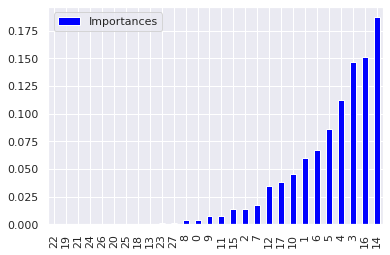

In [ ]:
#plot important features in bar diagram
final_df.plot.bar(color = 'blue')

In [ ]:
#take the names of the best features
imp_features = final_df['Features'][11:].values
imp_features

array(['COMMERCIAL UNITS', 'TOTAL UNITS', 'BOROUGH', 'GROSS SQUARE FEET',
       'YEAR SELL', 'BUILDING CLASS CATEGORY', 'RESIDENTIAL UNITS',
       'YEAR BUILT', 'AGE', 'LAND SQUARE FEET', 'ZIP CODE',
       'NEIGHBORHOOD', 'BUILDING CLASS AT PRESENT', 'LOT', 'MONTH SELL',
       'BLOCK', 'BUILDING CLASS AT TIME OF SALE'], dtype=object)

##correlation matrix

Text(0.5, 1.0, 'Variable Correlation')

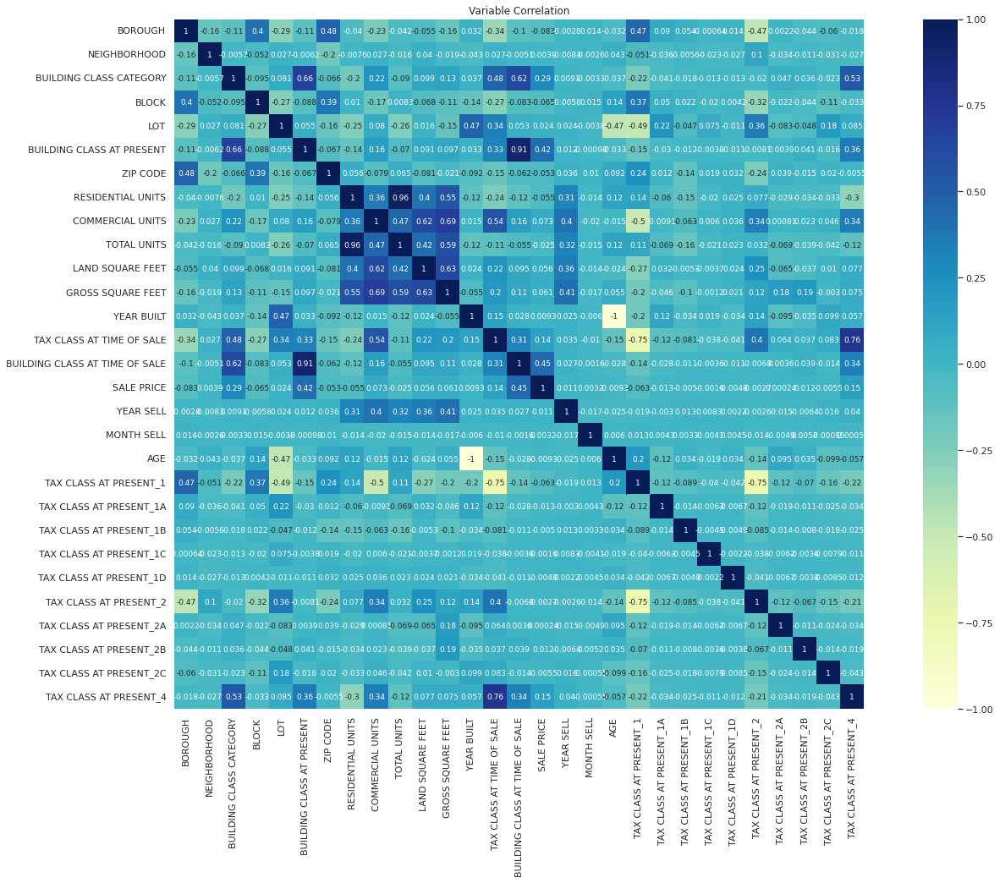

In [ ]:
#correlation matrix
corrmat = df.corr()
f, ax = plt.subplots(figsize=(25, 15))
sns.heatmap(corrmat, cmap = 'YlGnBu', square=True, annot= True, annot_kws={"size": 9})
plt.title('Variable Correlation')

##Build a MODEL

In [ ]:
#important features
X = df[list(imp_features)]

In [ ]:
X.head()

,COMMERCIAL UNITS,TOTAL UNITS,BOROUGH,GROSS SQUARE FEET,YEAR SELL,BUILDING CLASS CATEGORY,RESIDENTIAL UNITS,YEAR BUILT,AGE,LAND SQUARE FEET,ZIP CODE,NEIGHBORHOOD,BUILDING CLASS AT PRESENT,LOT,MONTH SELL,BLOCK,BUILDING CLASS AT TIME OF SALE
0,1.507426,-0.499998,-1.491352,-1.022810,-1.136472,6.946857,-1.463013,0.973840,-0.973840,-0.942841,-1.124879,-0.346496,4.743929,1.343712,0.431660,-1.092019,1.992433
1,-0.619741,-0.499998,-1.491352,1.863368,-1.136472,-0.275561,-0.431674,1.863559,-1.863559,-0.751894,-1.109584,-0.332912,0.520541,-0.657881,0.142447,-1.104245,0.476674
2,-0.619741,-0.499998,-1.491352,1.099222,-1.136472,-0.275561,-0.431674,-0.471953,0.471953,-0.942841,-1.109584,-0.332912,-0.209870,-0.621671,0.142447,-1.085567,-0.199463
3,-0.619741,-0.499998,-1.491352,1.647879,-1.136472,-0.275561,-0.431674,-0.471953,0.471953,-0.626094,-1.109584,-0.332912,0.520541,-0.577415,-1.303622,-1.085227,0.476674
4,-0.619741,-0.499998,-1.491352,1.244410,-1.136472,-0.275561,-0.431674,-0.471953,0.471953,-0.925244,-1.109584,-0.332912,-0.209870,-0.637764,0.142447,-1.084548,-0.199463


In [ ]:
#target value
Y.head()

0   -0.095430
1    1.211974
2    0.670944
3    0.749206
4    1.538634
Name: SALE PRICE, dtype: float64

In [ ]:
#splite the data into Train and Test by 70% for training to 30% for testing
xTrain, xTest, yTrain, yTest = train_test_split(X, Y, test_size = .3, random_state = 42, shuffle = True)
print(xTrain.shape)
print(xTest.shape)
print(yTrain.shape)
print(yTest.shape)

(110449, 17)
(47336, 17)
(110449,)
(47336,)


In [ ]:
#create RandomForest Model
model_imp = RandomForestRegressor(n_estimators=100, random_state = 42)
model_imp.fit(X, Y)

RandomForestRegressor(random_state=42)

In [ ]:
#test the accuracy of model on training set
print('D_Tree Train Score is : ' , model_imp.score(xTrain, yTrain))

D_Tree Train Score is :  0.9016645503228126


##LR MODEL

In [ ]:
# Create linear regression model
regressor = LinearRegression()
regressor.fit(xTrain,yTrain)

LinearRegression()

In [ ]:
#make data prediction
yPred = regressor.predict(xTest)

In [ ]:
print('MAE:',metrics.mean_absolute_error(yTest,yPred))
print('MSE:',metrics.mean_squared_error(yTest,yPred))
print('RMSE:',np.sqrt(metrics.mean_squared_error(yTest,yPred)))
print('R^2 =',metrics.explained_variance_score(yTest,yPred))

MAE: 0.12058925015036724
MSE: 0.47538904719252456
RMSE: 0.6894846243336573
R^2 = 0.11184563598815489


#Task 5: AutoMLUsing Auto-sklearn to explore performance of one state-of-the-art autoML tool on the given data (after your previous preprocessing). Optional: compare with performing autosklearn on raw data.
ref. https://automl.github.io/auto-sklearn/master/examples/20_basic/example_regression.html

In [ ]:
# train models with AutoML
automl = AutoML(mode="Explain")
automl.fit(xTrain, yTrain)

Linear algorithm was disabled.
AutoML directory: AutoML_1
The task is regression with evaluation metric rmse
AutoML will use algorithms: ['Baseline', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 2 models
1_Baseline rmse 1.262723 trained in 1.4 seconds
2_DecisionTree rmse 1.508899 trained in 16.76 seconds
* Step default_algorithms will try to check up to 3 models


2022-04-26 02:09:58,802 concurrent.futures ERROR exception calling callback for <Future at 0x7f5a9b06c9d0 state=finished raised BrokenProcessPool>
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/externals/loky/process_executor.py", line 407, in _process_worker
    call_item = call_queue.get(block=True, timeout=timeout)
  File "/usr/lib/python3.7/multiprocessing/queues.py", line 113, in get
    return _ForkingPickler.loads(res)
  File "/usr/local/lib/python3.7/dist-packages/xgboost/core.py", line 1497, in __setstate__
    _LIB.XGBoosterUnserializeFromBuffer(handle, ptr, length))
  File "/usr/local/lib/python3.7/dist-packages/xgboost/core.py", line 203, in _check_call
    raise XGBoostError(py_str(_LIB.XGBGetLastError()))
xgboost.core.XGBoostError: [02:09:58] ../src/learner.cc:1059: Check failed: header == serialisation_header_: 
  If you are loading a serialized model (like pickle in P

A task has failed to un-serialize. Please ensure that the arguments of the function are all picklable.
Problem during computing permutation importance. Skipping ...
3_Default_Xgboost rmse 1.206839 trained in 7.26 seconds
4_Default_NeuralNetwork rmse 1.188284 trained in 20.29 seconds
5_Default_RandomForest rmse 1.149577 trained in 44.95 seconds
* Step ensemble will try to check up to 1 model
Ensemble rmse 1.146648 trained in 0.65 seconds
AutoML fit time: 104.19 seconds
AutoML best model: Ensemble
Test MSE: 0.4562439046512229


In [ ]:
# compute the MSE on test data
predictions = automl.predict(xTest)
print('MAE:',metrics.mean_absolute_error(yTest,predictions))
print('MSE:',metrics.mean_squared_error(yTest,predictions))
print('RMSE:',np.sqrt(metrics.mean_squared_error(yTest,predictions)))
print('R^2 =',metrics.explained_variance_score(yTest,predictions))

MAE: 0.10960326502318435
MSE: 0.4562439046512229
RMSE: 0.6754582923106525
R^2 = 0.14804570826351815


#Ref

[R](https://www.pluralsight.com/guides/cleaning-up-data-from-outliers)

[R](https://contrib.scikit-learn.org/category_encoders/targetencoder.html)

[R](https://medium.com/analytics-vidhya/target-encoding-vs-one-hot-encoding-with-simple-examples-276a7e7b3e64)

[R](https://stackoverflow.com/questions/54265717/cannot-import-category-encoders-module)

[R](https://www.kaggle.com/code/eric8395/nyc-property-sales-eda-analysis-w-regression/notebook)

[R](https://towardsdatascience.com/feature-selection-using-random-forest-26d7b747597f)

[R](https://www.yourdatateacher.com/2021/10/11/feature-selection-with-random-forest/)

[R](https://xgboost.readthedocs.io/en/stable/parameter.html)

[R](https://www.datacamp.com/community/tutorials/feature-selection-python)